In [1]:
import os
import scanpy as sc
import numpy as np
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
from scipy.linalg import eigh
from matplotlib.colors import Normalize, TwoSlopeNorm
import matplotlib as mpl
import gseapy as gp
import seaborn as sns

In [2]:
figpath = '/stanley/WangLab/kamal/figures/projects/manifesto/interactions_human_lymph_node/'
os.makedirs(figpath, exist_ok=True)
dpi = 500

# Load

In [3]:
adata = sc.read_h5ad('/stanley/WangLab/kamal/data/technologies/xenium/human_lymph_node/filtered/adata.h5ad')

In [4]:
max_mag = 2

# Scale
sc.pp.scale(adata, layer='lowpass')
sc.pp.scale(adata, layer='highpass')

# Clip
X = adata.layers['lowpass']
X[X > max_mag] = max_mag
X[X < -max_mag] = -max_mag
X = adata.layers['highpass']
X[X > max_mag] = max_mag
X[X < -max_mag] = -max_mag

# Spatially arrange
adata.obsm['spatial'][:,1] *= -1

# Set figure size
width = adata.obsm['spatial'][:,0].ptp()
height = adata.obsm['spatial'][:,1].ptp()
set_width = 4
norm = set_width / width
sc.set_figure_params(figsize=(set_width, height*norm))

# Plot filtered gene

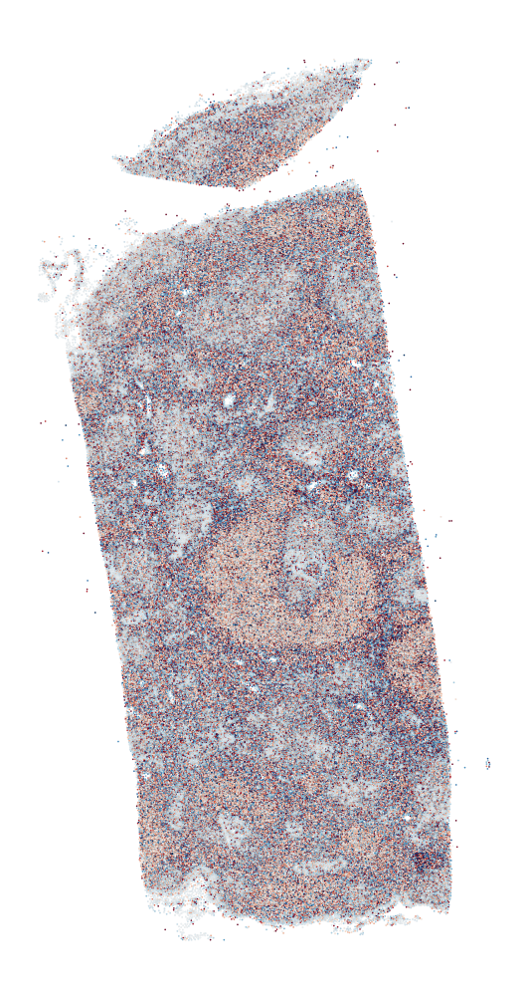

In [5]:
gene = 'TRAC'
points = adata.obsm['spatial']
plt.figure(figsize=(4,8))
plt.scatter(
    points[:,0],
    points[:,1],
    edgecolor='k',
    linewidth=0.01,
    s=0.5,
    c=adata[:,[gene]].layers['highpass'].flatten(),
    cmap='RdBu_r',
)
plt.axis('off')
filename = os.path.join(figpath, f'{gene}_highpass.png')
# plt.savefig(filename, dpi=300)
plt.show()

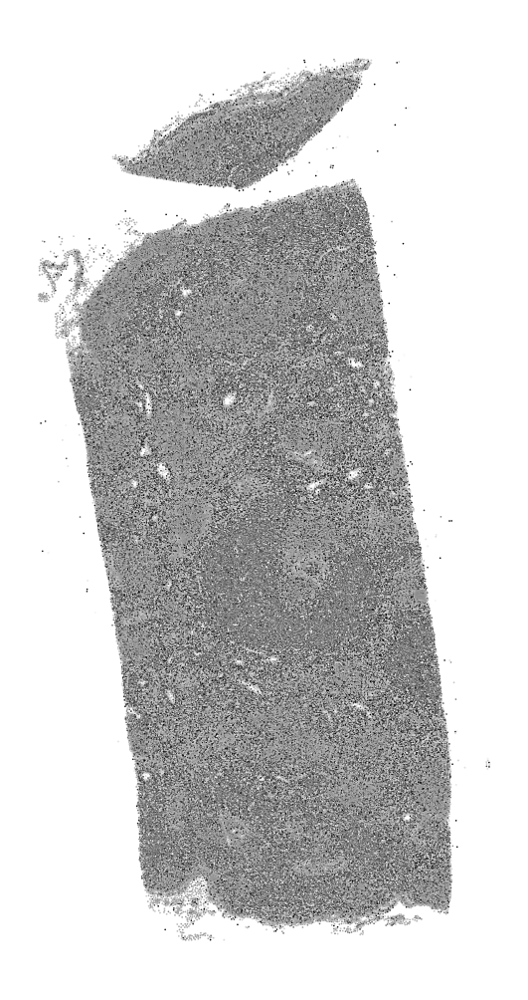

In [6]:
gene = 'TRAC'
points = adata.obsm['spatial']
plt.figure(figsize=(4,8))
plt.scatter(
    points[:,0],
    points[:,1],
    edgecolor='k',
    linewidth=0.01,
    s=0.5,
    c=adata[:,[gene]].layers['highpass'].flatten(),
    cmap='Greys',
)
plt.axis('off')
filename = os.path.join(figpath, f'{gene}_highpass_greys.png')
# plt.savefig(filename, dpi=300)
plt.show()

# PCA

In [7]:
n_pcs = 3
pca = PCA(n_components=n_pcs, random_state=0)
adata.obsm['X_pca_highpass'] = pca.fit_transform(adata.layers['highpass'])
adata.varm['X_pca_highpass'] = pca.components_.T

## Plot multiple PCs

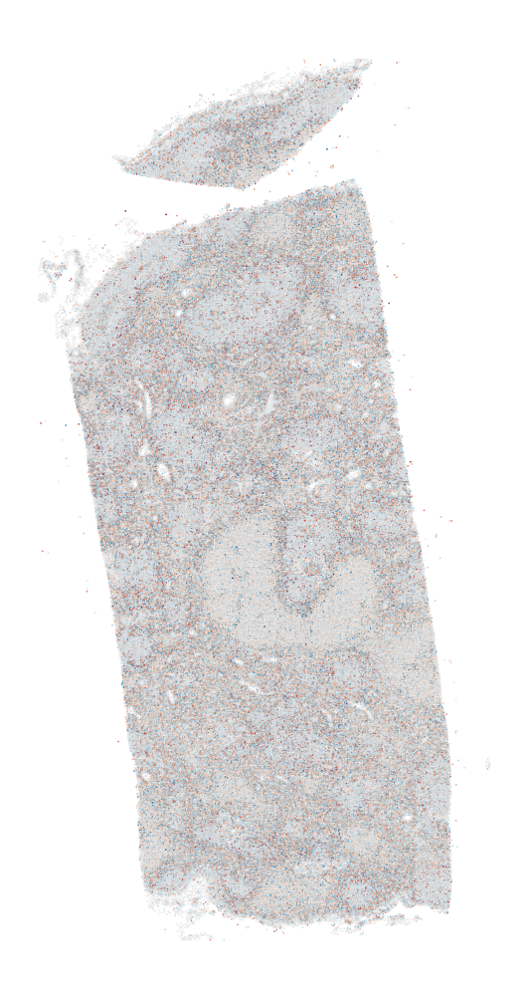

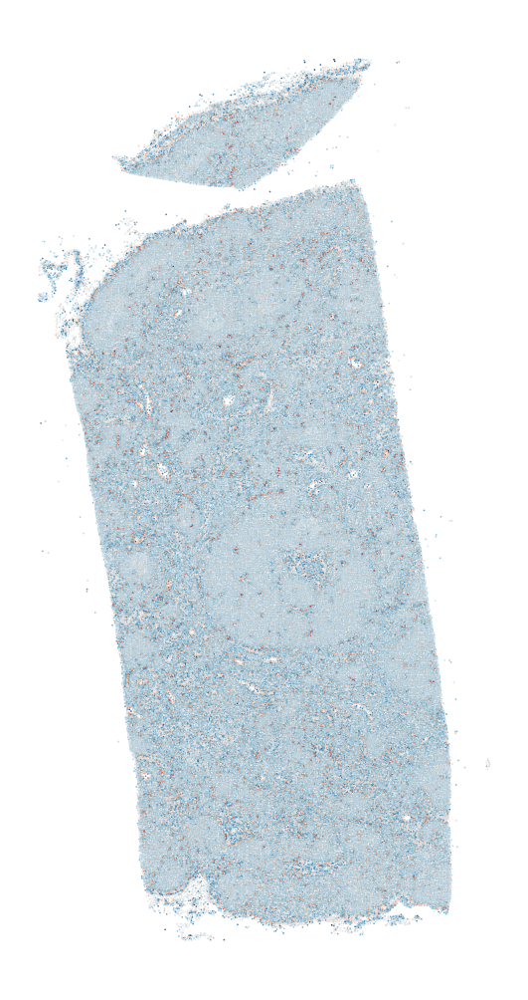

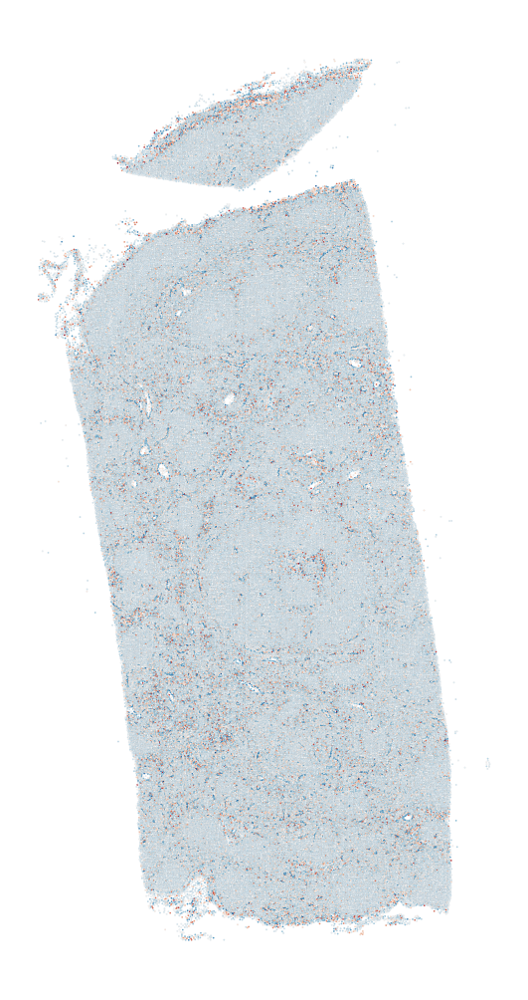

In [8]:
for i in range(n_pcs):

    points = adata.obsm['spatial']
    plt.figure(figsize=(4,8))
    plt.scatter(
        points[:,0],
        points[:,1],
        edgecolor='k',
        linewidth=0.01,
        s=0.5,
        c=adata.obsm['X_pca_highpass'][:,i],
        cmap='RdBu_r',
    )
    plt.axis('off')
    # filename = os.path.join(figpath, f'PC1_highpass.png')
    # plt.savefig(filename, dpi=300)
    plt.show()

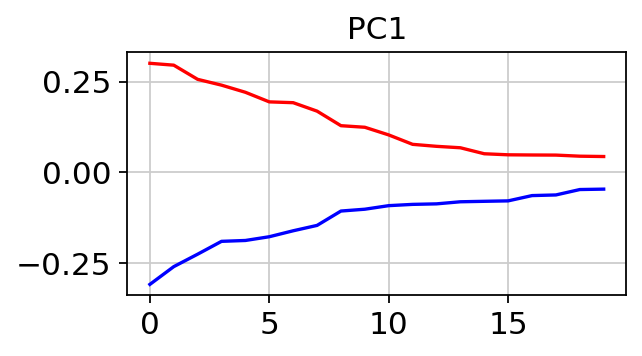

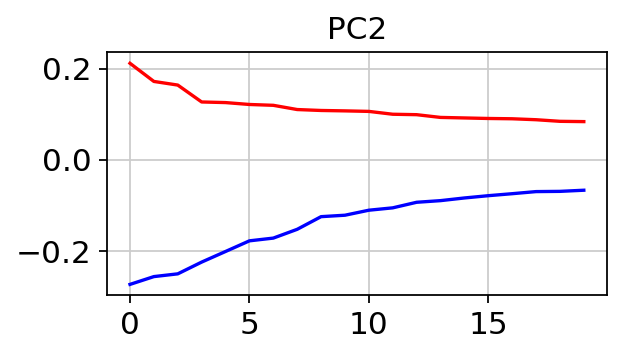

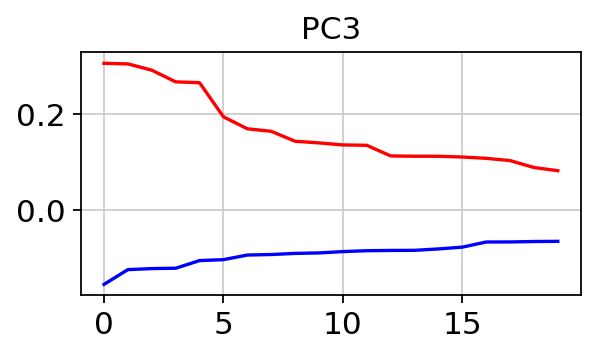

In [9]:
filter_key = 'highpass'
for i in range(n_pcs):
    plt.figure(figsize=(4,2))
    plt.title(f'PC{i+1}')
    plt.plot(np.sort(adata.varm[f'X_pca_{filter_key}'][:,i])[::-1][:20], c='r')
    plt.plot(np.sort(adata.varm[f'X_pca_{filter_key}'][:,i])[:20], c='b')
    plt.show()

In [10]:
n_markers = 10
for i in range(n_pcs):
    marker_idxs = np.argsort(adata.varm['X_pca_highpass'][:,i])
    pos_marker_genes = adata.var_names[marker_idxs[::-1]][:n_markers]
    neg_marker_genes = adata.var_names[marker_idxs][:n_markers]

    print(f'========== PC{i+1} ==========')
    print('Positive markers: ', list(pos_marker_genes))
    print('Negative markers: ', list(neg_marker_genes))

========== PC1 ==========
Positive markers:  ['TRAC', 'IL7R', 'CD3E', 'CD3D', 'CD2', 'CD28', 'CD247', 'CYTIP', 'CCR7', 'PTPRC']
Negative markers:  ['MS4A1', 'BANK1', 'CD79A', 'CD19', 'IRF8', 'PLCG2', 'ADAM28', 'MPEG1', 'BASP1', 'MEF2C']
========== PC2 ==========
Positive markers:  ['PTGDS', 'PECAM1', 'TFPI', 'CAVIN1', 'TNC', 'CD34', 'VWF', 'MYLK', 'DST', 'CD93']
Negative markers:  ['CXCR4', 'MS4A1', 'PTPRC', 'BANK1', 'CD79A', 'SELL', 'CYTIP', 'CD19', 'TRAC', 'ADAM28']
========== PC3 ==========
Positive markers:  ['CD4', 'MPEG1', 'FGL2', 'MS4A6A', 'AIF1', 'IGSF6', 'PLA2G7', 'C1orf162', 'CD68', 'CD163']
Negative markers:  ['PECAM1', 'TFPI', 'VWF', 'CD34', 'CAVIN1', 'MS4A1', 'ADGRL4', 'CAVIN2', 'CD79A', 'MMRN1']


## PC1

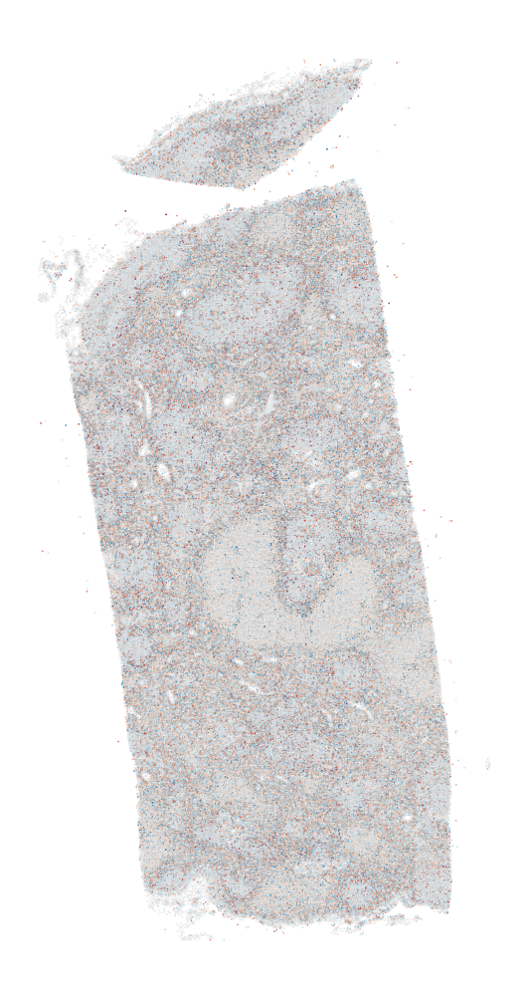

In [11]:
points = adata.obsm['spatial']
plt.figure(figsize=(4,8))
plt.scatter(
    points[:,0],
    points[:,1],
    edgecolor='k',
    linewidth=0.01,
    s=0.5,
    c=adata.obsm['X_pca_highpass'][:,0],
    cmap='RdBu_r',
)
plt.axis('off')
filename = os.path.join(figpath, f'PC1_highpass.png')
plt.savefig(filename, dpi=300)
plt.show()

In [13]:
# Set zoom dims
width = adata.obsm['spatial'][:,0].ptp()
height = adata.obsm['spatial'][:,1].ptp()
zoom_width = height/10
zoom_height = height/8

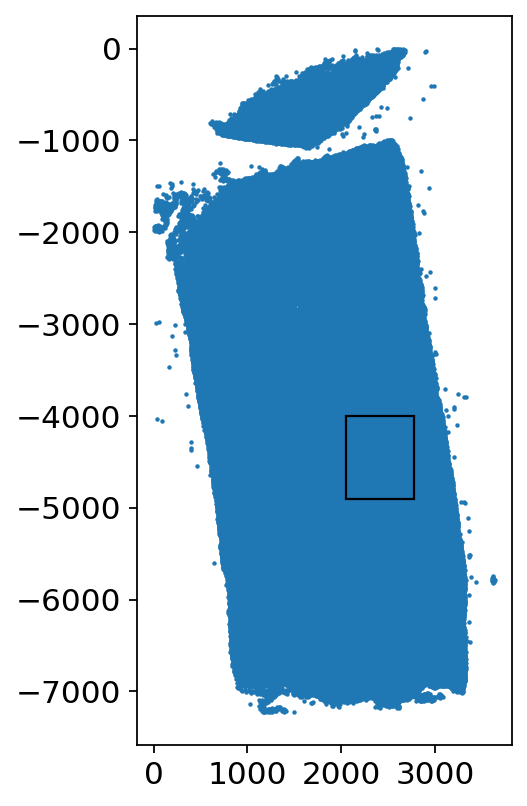

In [14]:
zoom_x = 2050
zoom_y = -4900

plt.figure(figsize=(3,6))
plt.scatter(*adata.obsm['spatial'].T, s=1)
rect = mpl.patches.Rectangle((zoom_x, zoom_y), zoom_width, zoom_height, edgecolor='k')
plt.gca().add_patch(rect)
plt.grid(None)
plt.show()

In [15]:
zdata = adata[adata.obsm['spatial'][:,0]>zoom_x]
zdata = zdata[zdata.obsm['spatial'][:,0]<zoom_x+zoom_width]
zdata = zdata[zdata.obsm['spatial'][:,1]>zoom_y]
zdata = zdata[zdata.obsm['spatial'][:,1]<zoom_y+zoom_height]

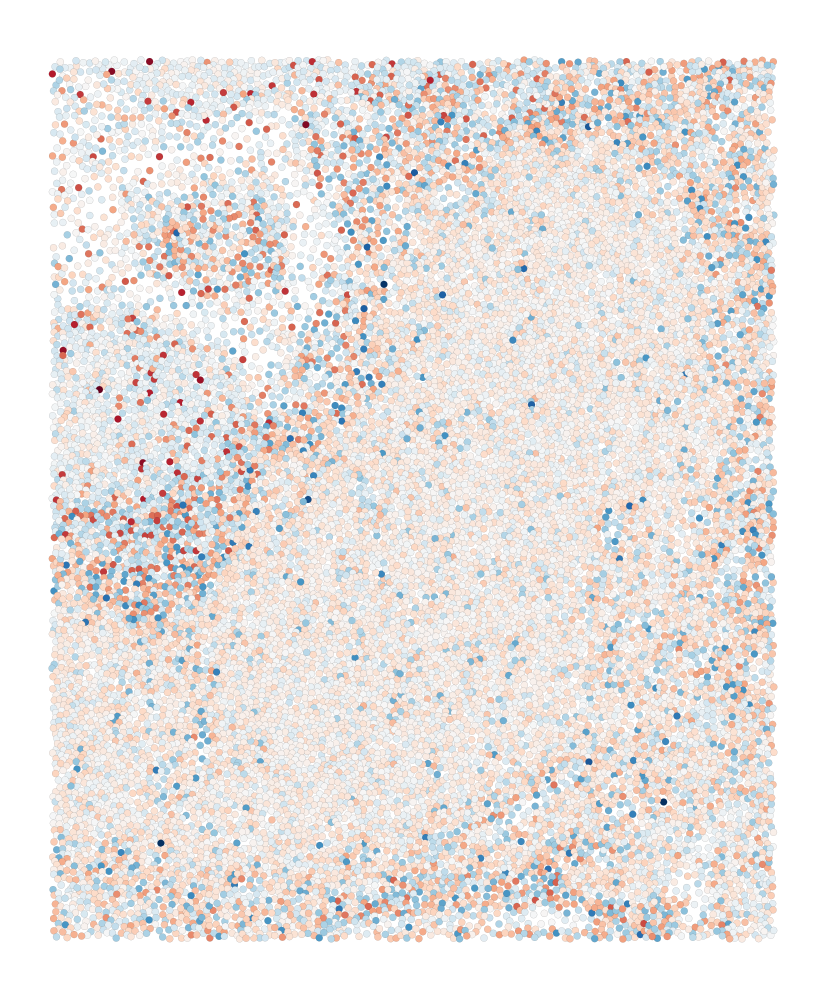

In [18]:
points = zdata.obsm['spatial']
plt.figure(figsize=(height*norm*(zoom_width/zoom_height), height*norm))
plt.scatter(
    points[:,0],
    points[:,1],
    edgecolor='k',
    linewidth=0.03,
    s=10,
    c=zdata.obsm['X_pca_highpass'][:,0],
    cmap='RdBu_r',
)
plt.axis('off')
filename = os.path.join(figpath, f'ixn_bad_zoom.png')
plt.savefig(filename, dpi=300)
plt.show()

In [21]:
n_markers = 5
n_comps = 2
for i in range(n_comps):
    marker_idxs = np.argsort(adata.varm['X_pca_highpass'][:,i])
    pos_marker_genes = adata.var_names[marker_idxs[::-1]][:n_markers]
    neg_marker_genes = adata.var_names[marker_idxs][:n_markers]

    print(f'========== PC{i+1} ==========')
    print('Positive markers: ', list(pos_marker_genes))
    print('Negative markers: ', list(neg_marker_genes))

========== PC1 ==========
Positive markers:  ['TRAC', 'IL7R', 'CD3E', 'CD3D', 'CD2']
Negative markers:  ['MS4A1', 'BANK1', 'CD79A', 'CD19', 'IRF8']
========== PC2 ==========
Positive markers:  ['PTGDS', 'PECAM1', 'TFPI', 'CAVIN1', 'TNC']
Negative markers:  ['CXCR4', 'MS4A1', 'PTPRC', 'BANK1', 'CD79A']


## PC2

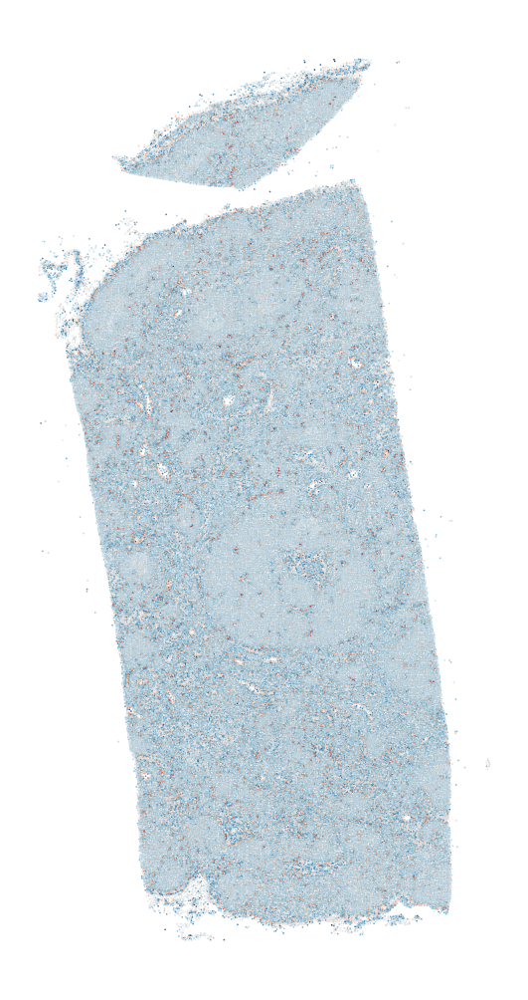

In [11]:
points = adata.obsm['spatial']
plt.figure(figsize=(4,8))
plt.scatter(
    points[:,0],
    points[:,1],
    edgecolor='k',
    linewidth=0.01,
    s=0.5,
    c=adata.obsm['X_pca_highpass'][:,1],
    cmap='RdBu_r',
)
plt.axis('off')
filename = os.path.join(figpath, f'PC2_highpass.png')
plt.savefig(filename, dpi=300)
plt.show()

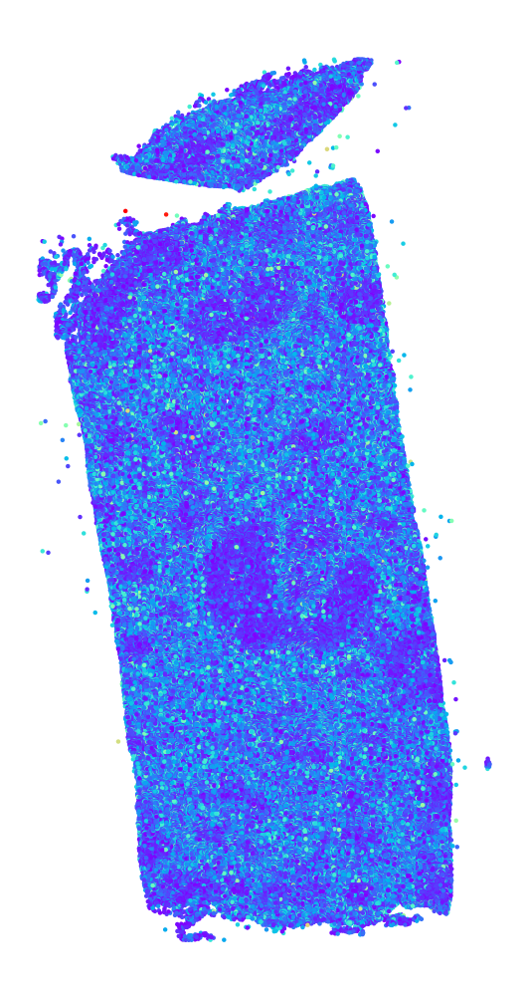

In [14]:
points = adata.obsm['spatial']
plt.figure(figsize=(4,8))
plt.scatter(
    points[:,0],
    points[:,1],
    s=1,
    c=np.abs(adata.obsm['X_pca_highpass'][:,1]),
    cmap='rainbow',
)
plt.axis('off')
plt.show()

In [12]:
# Set zoom dims
width = adata.obsm['spatial'][:,0].ptp()
height = adata.obsm['spatial'][:,1].ptp()
zoom_width = height/10
zoom_height = height/8

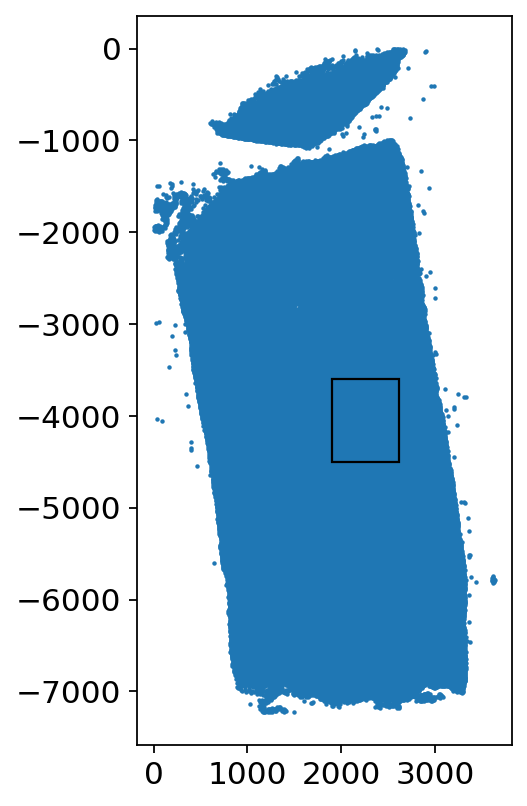

In [13]:
zoom_x = 1900
zoom_y = -4500

plt.figure(figsize=(3,6))
plt.scatter(*adata.obsm['spatial'].T, s=1)
rect = mpl.patches.Rectangle((zoom_x, zoom_y), zoom_width, zoom_height, edgecolor='k')
plt.gca().add_patch(rect)
plt.grid(None)
plt.show()

In [14]:
zdata = adata[adata.obsm['spatial'][:,0]>zoom_x]
zdata = zdata[zdata.obsm['spatial'][:,0]<zoom_x+zoom_width]
zdata = zdata[zdata.obsm['spatial'][:,1]>zoom_y]
zdata = zdata[zdata.obsm['spatial'][:,1]<zoom_y+zoom_height]

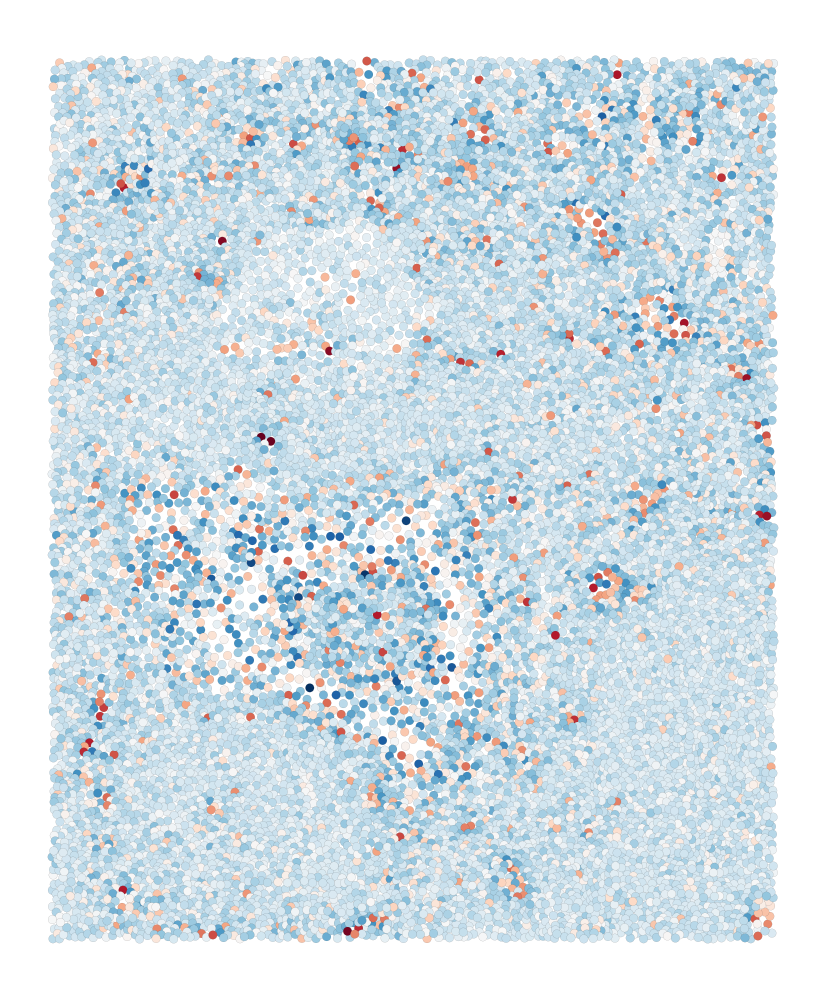

In [15]:
points = zdata.obsm['spatial']
plt.figure(figsize=(height*norm*(zoom_width/zoom_height), height*norm))
plt.scatter(
    points[:,0],
    points[:,1],
    edgecolor='k',
    linewidth=0.03,
    s=15,
    c=zdata.obsm['X_pca_highpass'][:,1],
    cmap='RdBu_r',
)
plt.axis('off')
filename = os.path.join(figpath, f'PC2_highpass_zoom.png')
plt.savefig(filename, dpi=300)
plt.show()

## PC3

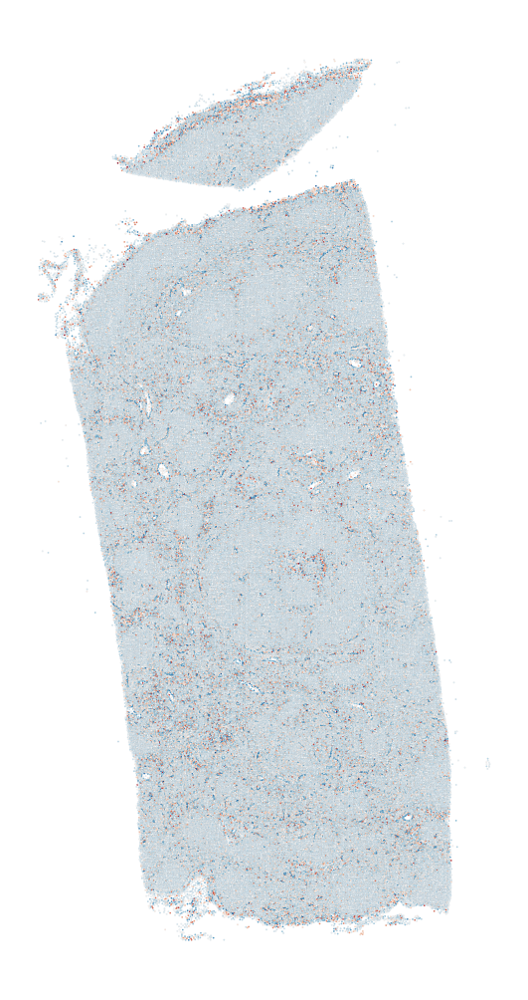

In [16]:
points = adata.obsm['spatial']
plt.figure(figsize=(4,8))
plt.scatter(
    points[:,0],
    points[:,1],
    edgecolor='k',
    linewidth=0.01,
    s=0.5,
    c=adata.obsm['X_pca_highpass'][:,2],
    cmap='RdBu_r',
)
plt.axis('off')
filename = os.path.join(figpath, f'PC3_highpass.png')
plt.savefig(filename, dpi=300)
plt.show()

In [17]:
# Set zoom dims
width = adata.obsm['spatial'][:,0].ptp()
height = adata.obsm['spatial'][:,1].ptp()
zoom_width = height/10
zoom_height = height/8

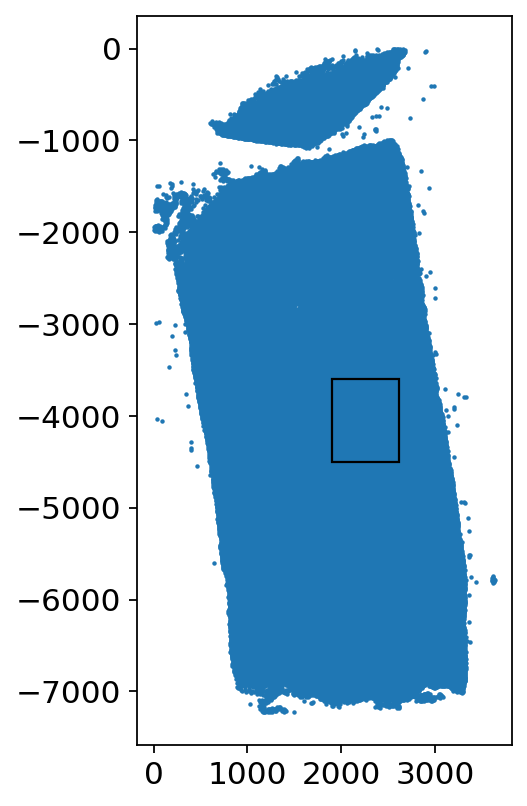

In [18]:
zoom_x = 1900
zoom_y = -4500

plt.figure(figsize=(3,6))
plt.scatter(*adata.obsm['spatial'].T, s=1)
rect = mpl.patches.Rectangle((zoom_x, zoom_y), zoom_width, zoom_height, edgecolor='k')
plt.gca().add_patch(rect)
plt.grid(None)
plt.show()

In [19]:
zdata = adata[adata.obsm['spatial'][:,0]>zoom_x]
zdata = zdata[zdata.obsm['spatial'][:,0]<zoom_x+zoom_width]
zdata = zdata[zdata.obsm['spatial'][:,1]>zoom_y]
zdata = zdata[zdata.obsm['spatial'][:,1]<zoom_y+zoom_height]

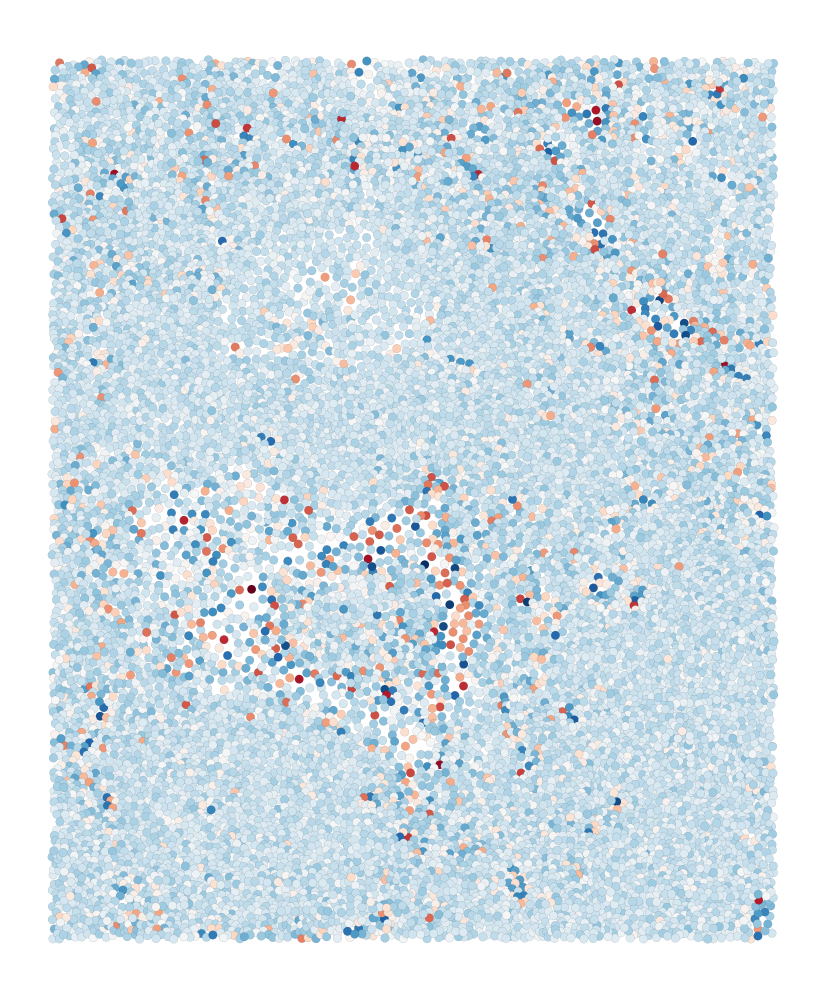

In [20]:
points = zdata.obsm['spatial']
plt.figure(figsize=(height*norm*(zoom_width/zoom_height), height*norm))
plt.scatter(
    points[:,0],
    points[:,1],
    edgecolor='k',
    linewidth=0.03,
    s=15,
    c=zdata.obsm['X_pca_highpass'][:,2],
    cmap='RdBu_r',
)
plt.axis('off')
filename = os.path.join(figpath, f'PC3_highpass_zoom.png')
plt.savefig(filename, dpi=300)
plt.show()

## GO terms

==================== PC1 ====================


,Term,Adjusted P-value,Genes
0,Glomerulus Vasculature Development (GO:0072012),0.000182,PECAM1;CD34
1,Endothelium Development (GO:0003158),0.000600,PECAM1;CD34
2,Phagocytosis (GO:0006909),0.014000,CD93;PECAM1
3,Positive Regulation Of Animal Organ Morphogene...,0.030887,CD34
4,Neutrophil Extravasation (GO:0072672),0.030887,PECAM1
5,Vascular Wound Healing (GO:0061042),0.030887,CD34
6,Hemostasis (GO:0007599),0.030887,VWF
7,Endocytosis (GO:0006897),0.030887,CD93;PECAM1
8,Positive Regulation Of Vasculogenesis (GO:2001...,0.030887,CD34
9,Negative Regulation Of Hemostasis (GO:1900047),0.030887,TFPI


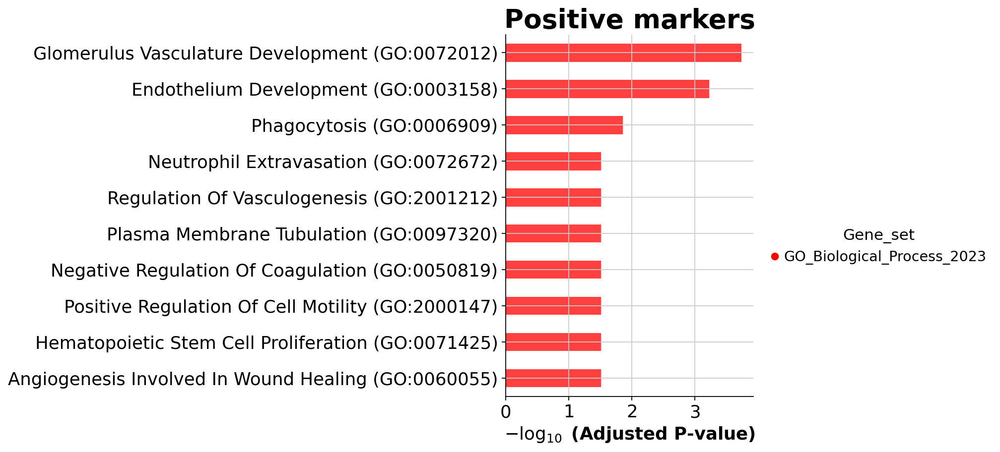

,Term,Adjusted P-value,Genes
0,T Cell Activation (GO:0042110),0.000032,CD2;PTPRC;CD3E;CD3D
1,Antigen Receptor-Mediated Signaling Pathway (G...,0.000034,PTPRC;CD3E;MS4A1;CD3D
2,B Cell Activation (GO:0042113),0.000526,PTPRC;BANK1;MS4A1
3,T Cell Receptor Signaling Pathway (GO:0050852),0.000526,PTPRC;CD3E;CD3D
4,Alpha-Beta T Cell Activation (GO:0046631),0.000815,CD3E;CD3D
5,B Cell Proliferation (GO:0042100),0.002993,PTPRC;MS4A1
6,Lymphocyte Proliferation (GO:0046651),0.003872,PTPRC;MS4A1
7,Natural Killer Cell Activation (GO:0030101),0.004424,CD2;PTPRC
8,B Cell Receptor Signaling Pathway (GO:0050853),0.004424,PTPRC;MS4A1
9,Positive Regulation Of T Cell Proliferation (G...,0.007909,PTPRC;CD3E


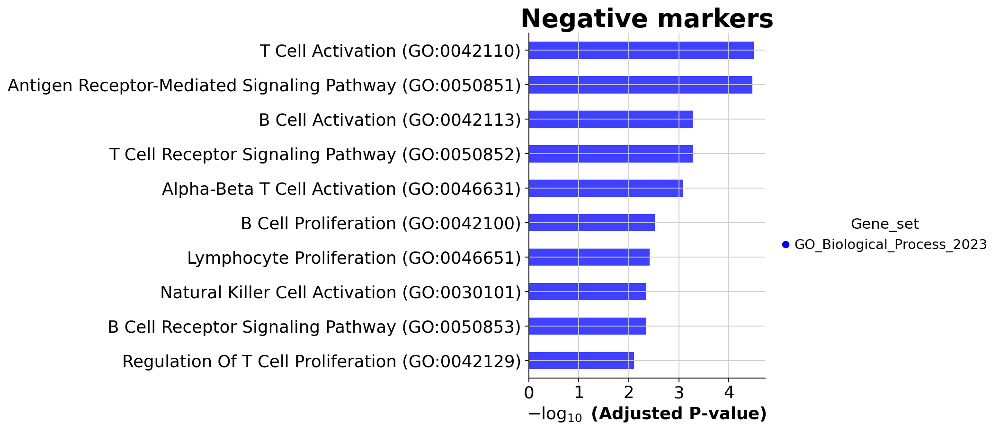

==================== PC2 ====================


,Term,Adjusted P-value,Genes
0,T Cell Receptor Signaling Pathway (GO:0050852),5.159988e-08,CD28;CTLA4;CD247;CD3E;CD3D
1,T Cell Activation (GO:0042110),5.687982e-08,CD2;CD28;CD247;CD3E;CD3D
2,Antigen Receptor-Mediated Signaling Pathway (G...,9.830586e-08,CD28;CTLA4;CD247;CD3E;CD3D
3,Alpha-Beta T Cell Activation (GO:0046631),9.797194e-07,CD247;CD3E;CD3D
4,Positive Regulation Of T Cell Proliferation (G...,8.836039e-03,CD28;CD3E
5,Positive Regulation Of Lymphocyte Proliferatio...,8.850160e-03,CD28;CD3E
6,Regulation Of T Cell Proliferation (GO:0042129),8.850160e-03,CD28;CD3E
7,Positive Regulation Of T Cell Activation (GO:0...,1.488915e-02,CD28;CD3E
8,Protein-Containing Complex Organization (GO:00...,1.828552e-02,CD247;CD3E
9,Positive Regulation Of Cell-Cell Adhesion Medi...,2.179818e-02,CD3E


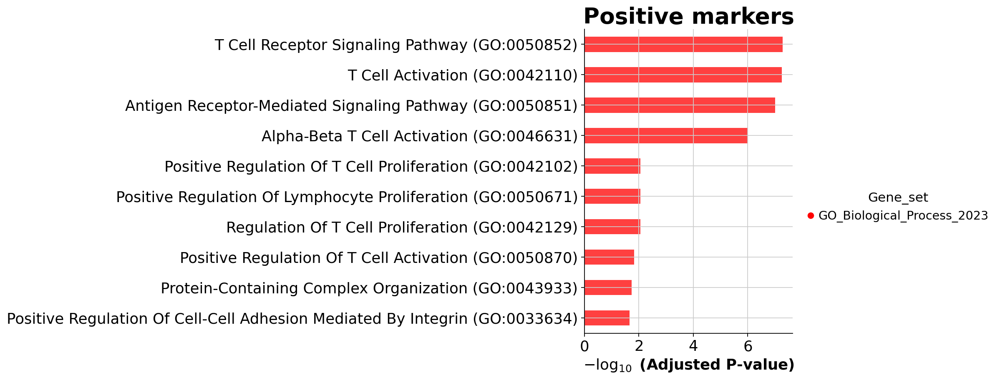

,Term,Adjusted P-value,Genes
0,B Cell Receptor Signaling Pathway (GO:0050853),7.786726e-07,CD79A;CD19;PLCG2;MS4A1
1,B Cell Activation (GO:0042113),6.593406e-06,CD79A;BANK1;PLCG2;MS4A1
2,Antigen Receptor-Mediated Signaling Pathway (G...,1.536137e-05,CD79A;CD19;PLCG2;MS4A1
3,B Cell Proliferation (GO:0042100),1.536137e-05,CD79A;CD19;MS4A1
4,B Cell Differentiation (GO:0030183),1.356926e-04,CD79A;PLCG2;MS4A1
5,Lymphocyte Differentiation (GO:0030098),2.724572e-04,CD79A;PLCG2;MS4A1
6,Negative Regulation Of B Cell Activation (GO:0...,9.299187e-04,TNFRSF13B;BANK1
7,Regulation Of B Cell Activation (GO:0050864),1.283049e-03,BANK1;CD19
8,Lymphocyte Proliferation (GO:0046651),2.663311e-03,CD79A;MS4A1
9,Regulation Of Peptidyl-Tyrosine Phosphorylatio...,1.346766e-02,BANK1;PLCG2


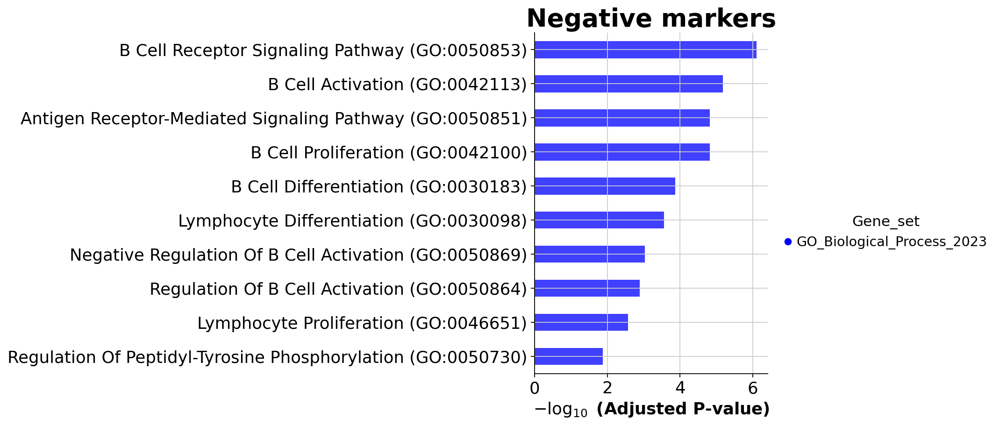

In [21]:
# n_markers = int(adata.shape[1] * 0.01) # top 1% of genes
n_markers = 10
gene_sets = [
    'GO_Biological_Process_2023',
    # 'GO_Molecular_Function_2023',
    # 'WikiPathways_2019_Mouse',
    # 'Elsevier_Pathway_Collection',
    # 'PFOCR_Pathways',
]
cutoff = 0.05

for i in range(2):

    print('='*20, f'PC{i+1}', '='*20)
    
    marker_idxs = np.argsort(adata.varm['X_pca_highpass'][:,i])
    pos_marker_genes = adata.var_names[marker_idxs[::-1]][:n_markers]
    neg_marker_genes = adata.var_names[marker_idxs][:n_markers]

    enrichment = gp.enrichr(
        gene_list=list(pos_marker_genes),
        organism='Mouse',
        gene_sets=gene_sets,
    )
    try:
        df = enrichment.results
        display(df[['Term', 'Adjusted P-value', 'Genes']][df['Adjusted P-value'] < cutoff][:20])
        fig = gp.barplot(df, title='Positive markers', group='Gene_set', color=['r'], cutoff=cutoff)
        plt.show()
    except:
        print('No significant terms')

    enrichment = gp.enrichr(
        gene_list=list(neg_marker_genes),
        organism='Mouse',
        gene_sets=gene_sets,
    )
    try:
        df = enrichment.results
        display(df[['Term', 'Adjusted P-value', 'Genes']][df['Adjusted P-value'] < cutoff][:20])
        fig = gp.barplot(df, title='Negative markers', group='Gene_set', color=['b'], cutoff=cutoff)
        plt.show()
    except:
        print('No significant terms')

# GED

## Get regions

In [5]:
n_pcs = 10
pca = PCA(n_components=n_pcs, random_state=0)
adata.obsm['X_pca_lowpass'] = pca.fit_transform(adata.layers['lowpass'])
adata.varm['X_pca_lowpass'] = pca.components_.T

In [6]:
n_regions = 3
kmeans = KMeans(n_clusters=n_regions, random_state=0)
kmeans.fit(adata.obsm['X_pca_lowpass'])
adata.obs['region'] = kmeans.labels_.astype(str)

/stanley/WangLab/kamal/envs/xax/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


In [12]:
regions = sorted(adata.obs['region'].unique())
colors = np.array(sc.pl.palettes.default_28)[[0,5,9]]
# colors = [
#     '#1B5B9C',
#     '#931A28',
#     '#FFC8C8',
#     # '#AADCFF',
# ]
palette = {region:color for region,color in zip(regions,colors)}

adata.obs['is_paracortex'] = adata.obs['region'] == '1'
paracortex_colormap = {True: colors[1], False: [0.8]*3}
adata.obs['paracortex_color'] = adata.obs['is_paracortex'].map(paracortex_colormap)

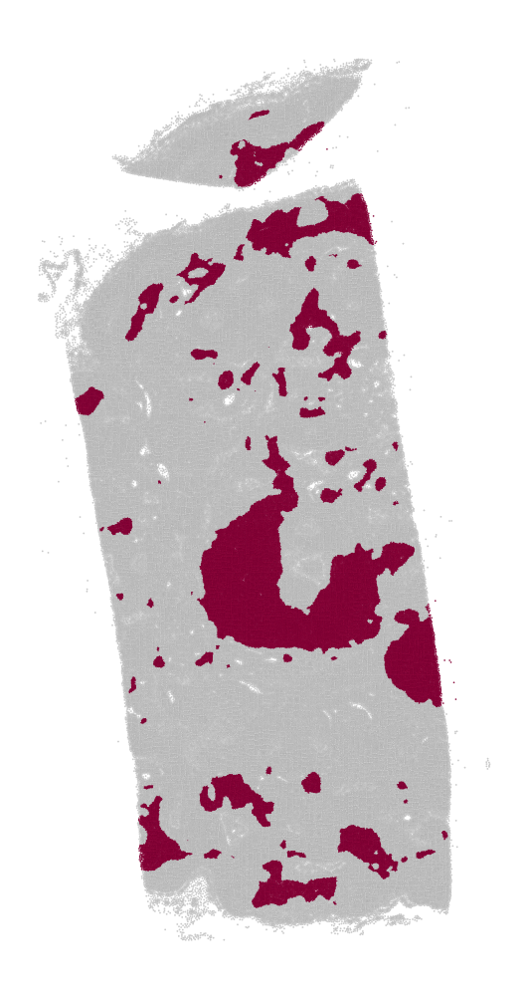

In [13]:
points = adata.obsm['spatial']
plt.figure(figsize=(4,8))
plt.scatter(
    points[:,0],
    points[:,1],
    edgecolor='k',
    linewidth=0.01,
    s=0.5,
    c=adata.obs['paracortex_color'],
)
plt.axis('off')
filename = os.path.join(figpath, 'paracortex.png')
plt.savefig(filename, dpi=dpi)
plt.show()

## Interactions

In [26]:
def embed(adata, region, n_comps, filter_key):

    adata_region = adata[adata.obs['region']==region]
    adata_notregion = adata[adata.obs['region']!=region]

    X = adata_region.layers[filter_key]
    X -= X.mean(axis=0)
    A = X.T @ X

    X_ = adata_notregion.layers[filter_key]
    X_ -= X_.mean(axis=0)
    B = X_.T @ X_

    w,V = eigh(A,B)
    w = w[::-1]
    V = V[:,::-1]

    V = V[:,:n_comps]
    adata.obsm[f'X_pca_{filter_key}'] = adata.layers[filter_key] @ V
    adata.varm[f'X_pca_{filter_key}'] = V
    adata.uns[f'comp_var_{filter_key}'] = w

    return V

### Paracortex

In [27]:
n_comps = 3
filter_key = 'highpass'
region = '1'

In [28]:
V = embed(adata, region, n_comps, filter_key)

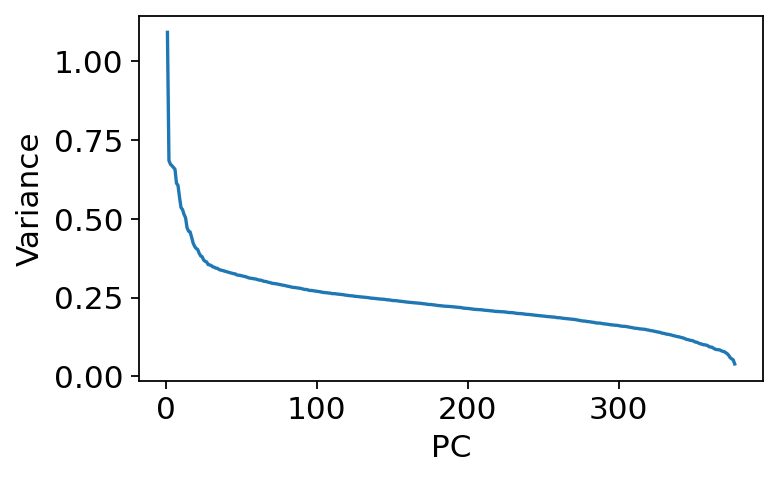

In [29]:
w = adata.uns[f'comp_var_{filter_key}']

plt.figure(figsize=(5,3))
plt.plot(np.arange(1,len(w)+1), w)
plt.xlabel('PC')
plt.ylabel('Variance')
plt.grid(None)
plt.show()

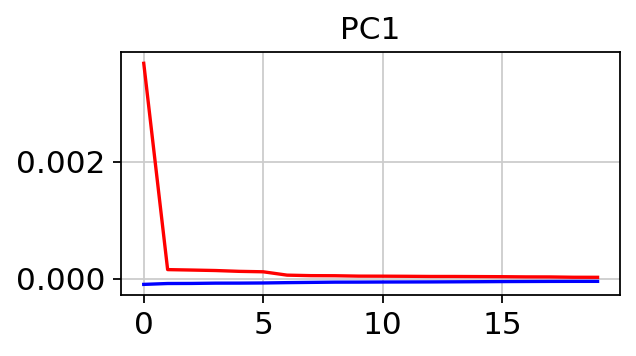

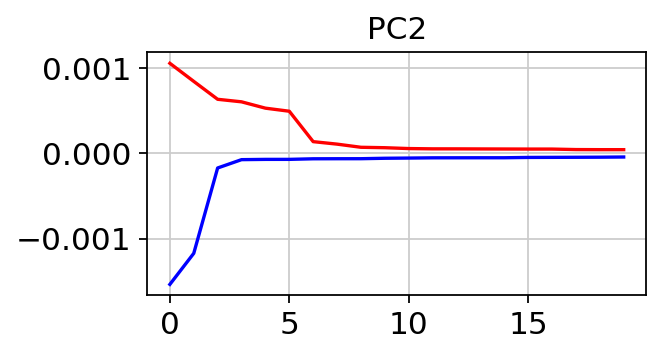

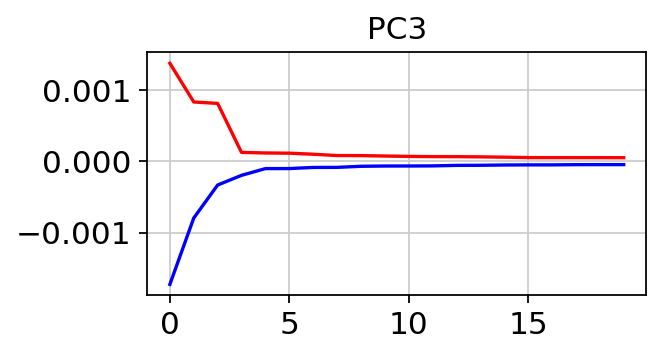

In [30]:
for i in range(n_comps):
    plt.figure(figsize=(4,2))
    plt.title(f'PC{i+1}')
    plt.plot(np.sort(adata.varm[f'X_pca_{filter_key}'][:,i])[::-1][:20], c='r')
    plt.plot(np.sort(adata.varm[f'X_pca_{filter_key}'][:,i])[:20], c='b')
    plt.show()

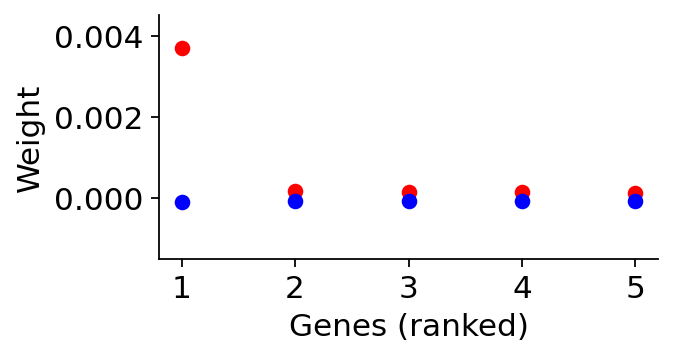

In [26]:
i = 0
n_dots = 5
x = np.arange(n_dots) + 1

plt.figure(figsize=(4,2))
y = np.sort(adata.varm[f'X_pca_{filter_key}'][:,i])[::-1][:n_dots]
plt.scatter(x,y, c='r')
y = np.sort(adata.varm[f'X_pca_{filter_key}'][:,i])[:n_dots]
plt.scatter(x,y, c='b')
plt.xlabel('Genes (ranked)')
plt.ylabel('Weight')
plt.ylim(-0.0015, 0.0045)
plt.grid(None)
plt.gca().spines[['right', 'top']].set_visible(False)

filename = os.path.join(figpath, 'weights.png')
plt.savefig(filename, dpi=dpi)

plt.show()

#### PC1

In [37]:
# Set figure size
width = adata.obsm['spatial'][:,0].ptp()
height = adata.obsm['spatial'][:,1].ptp()
set_width = 4
fignorm = set_width / width
sc.set_figure_params(figsize=(set_width, height*fignorm))

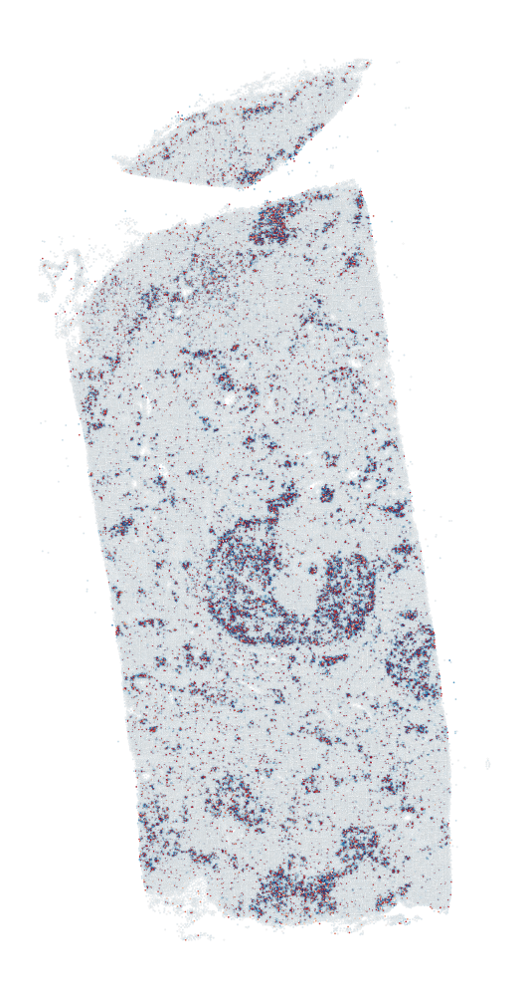

In [31]:
pc = 0
adata.obs[f'PC{pc+1}'] = adata.obsm[f'X_pca_highpass'][:,pc]

points = adata.obsm['spatial']
plt.figure(figsize=(4,8))
plt.scatter(
    points[:,0],
    points[:,1],
    edgecolor='k',
    linewidth=0.01,
    s=0.5,
    c=adata.obsm['X_pca_highpass'][:,pc],
    cmap='RdBu_r',
)
plt.axis('off')
filename = os.path.join(figpath, f'ixn_paracortex.png')
# plt.savefig(filename, dpi=300)
plt.show()

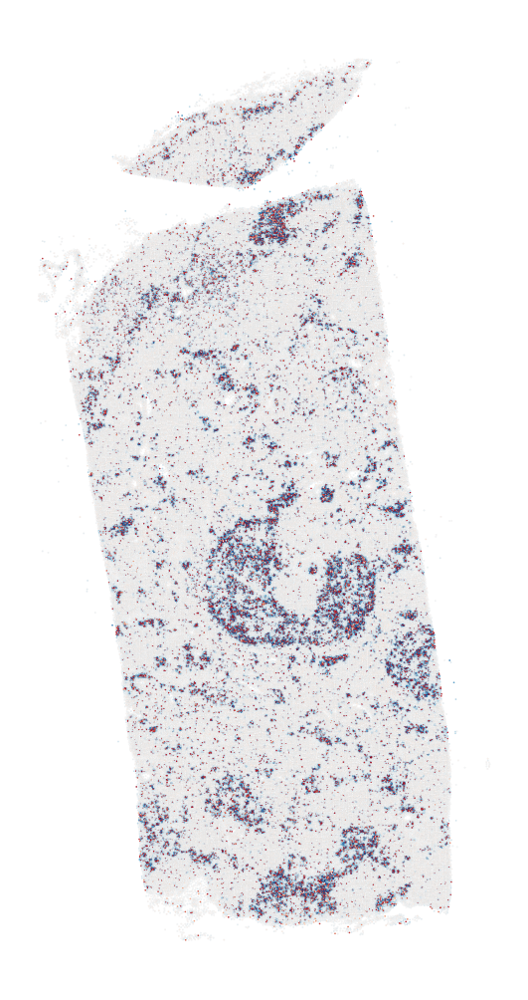

In [32]:
pc = 0
# adata.obs[f'PC{pc+1}'] = adata.obsm[f'X_pca_highpass'][:,pc]
c = adata.obsm['X_pca_highpass'][:,pc]
# norm = Normalize(vmin=-np.abs(c).max(), vmax=np.abs(c).max())
norm = TwoSlopeNorm(vcenter=0, vmin=c.min(), vmax=c.max())

points = adata.obsm['spatial']
plt.figure(figsize=(4,8))
plt.scatter(
    points[:,0],
    points[:,1],
    edgecolor='k',
    linewidth=0.005,
    s=0.5,
    c=c,
    cmap='RdBu_r',
    norm=norm,
)
plt.axis('off')
filename = os.path.join(figpath, f'ixn_tzone.png')
plt.savefig(filename, dpi=300)
plt.show()

In [33]:
# Set zoom dims
width = adata.obsm['spatial'][:,0].ptp()
height = adata.obsm['spatial'][:,1].ptp()
zoom_width = height/10
zoom_height = height/8

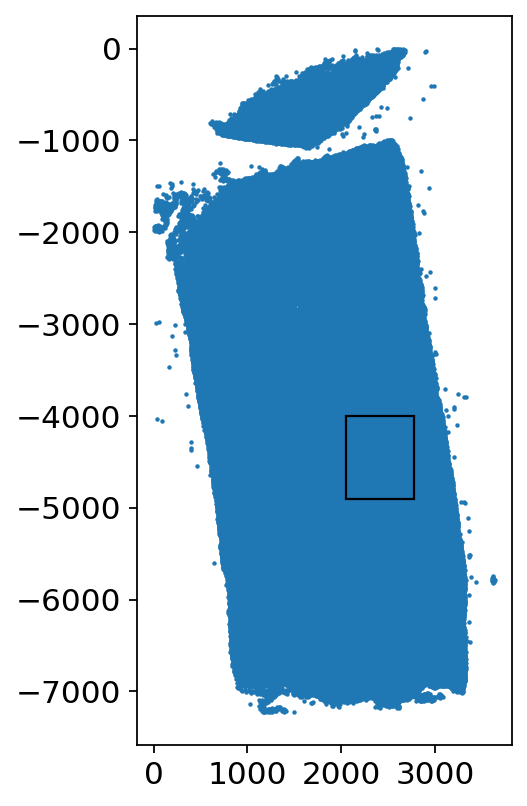

In [34]:
zoom_x = 2050
zoom_y = -4900

plt.figure(figsize=(3,6))
plt.scatter(*adata.obsm['spatial'].T, s=1)
rect = mpl.patches.Rectangle((zoom_x, zoom_y), zoom_width, zoom_height, edgecolor='k')
plt.gca().add_patch(rect)
plt.grid(None)
plt.show()

In [35]:
zdata = adata[adata.obsm['spatial'][:,0]>zoom_x]
zdata = zdata[zdata.obsm['spatial'][:,0]<zoom_x+zoom_width]
zdata = zdata[zdata.obsm['spatial'][:,1]>zoom_y]
zdata = zdata[zdata.obsm['spatial'][:,1]<zoom_y+zoom_height]

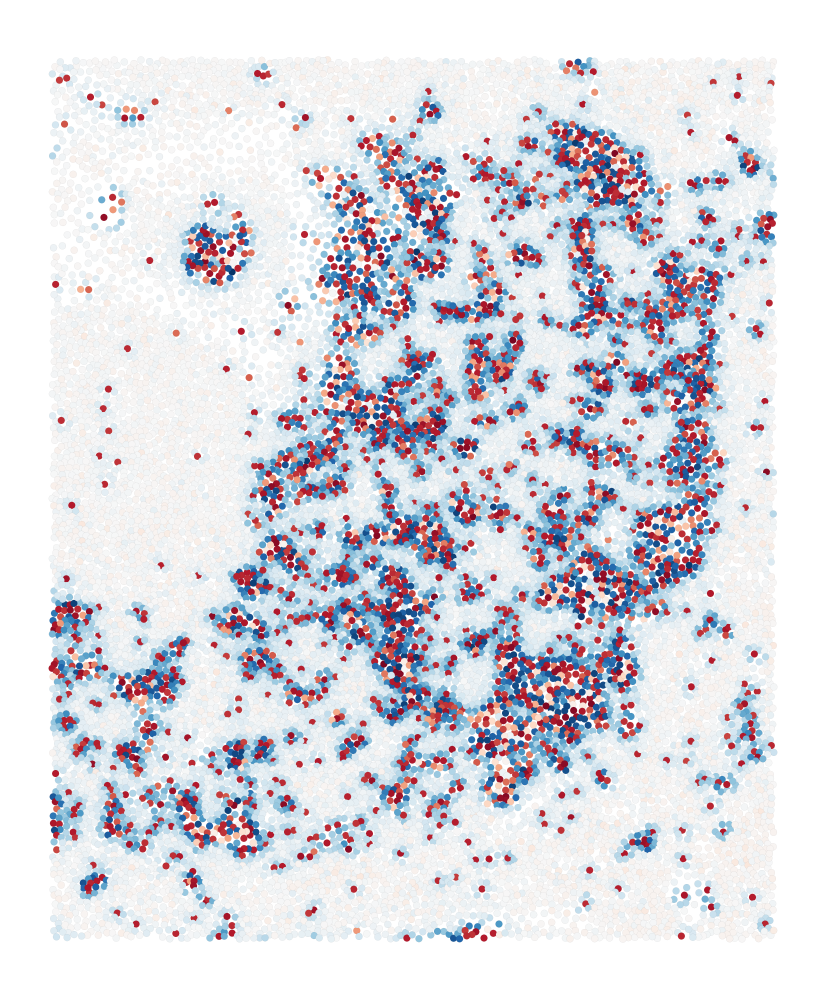

In [38]:
points = zdata.obsm['spatial']
plt.figure(figsize=(height*fignorm*(zoom_width/zoom_height), height*fignorm))
plt.scatter(
    points[:,0],
    points[:,1],
    edgecolor='k',
    linewidth=0.01,
    s=10,
    c=zdata.obsm['X_pca_highpass'][:,0],
    cmap='RdBu_r',
    norm=norm,
)
plt.axis('off')
filename = os.path.join(figpath, f'ixn_tzone_zoom.png')
plt.savefig(filename, dpi=300)
plt.show()

In [39]:
n_markers = 5
for i in range(n_comps):
    marker_idxs = np.argsort(adata.varm[f'X_pca_{filter_key}'][:,i])
    pos_marker_genes = adata.var_names[marker_idxs[::-1]][:n_markers]
    neg_marker_genes = adata.var_names[marker_idxs][:n_markers]

    print(f'========== PC{i+1} ==========')
    print('Positive markers: ', list(pos_marker_genes))
    print('Negative markers: ', list(neg_marker_genes))

========== PC1 ==========
Positive markers:  ['LAMP3', 'CSF2RA', 'CCR7', 'CCL19', 'CD1E']
Negative markers:  ['AQP3', 'CD247', 'CD3D', 'HLA-DQB2', 'CD28']
========== PC2 ==========
Positive markers:  ['CD8A', 'CD2', 'CTLA4', 'CD28', 'CCL19']
Negative markers:  ['CD3D', 'CD247', 'LAMP3', 'SST', 'TSPAN19']
========== PC3 ==========
Positive markers:  ['CD28', 'CD247', 'CCL19', 'DES', 'CD4']
Negative markers:  ['CD8A', 'CD3D', 'CD3E', 'FOXP3', 'IL7R']


#### PC2

In [40]:
# Set figure size
width = adata.obsm['spatial'][:,0].ptp()
height = adata.obsm['spatial'][:,1].ptp()
set_width = 4
fignorm = set_width / width
sc.set_figure_params(figsize=(set_width, height*fignorm))

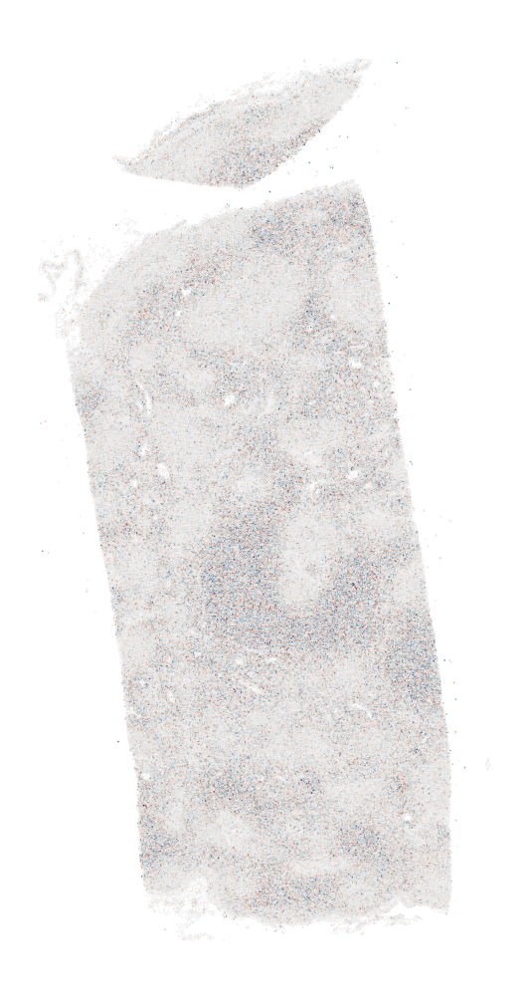

In [42]:
pc = 1
# adata.obs[f'PC{pc+1}'] = adata.obsm[f'X_pca_highpass'][:,pc]
c = adata.obsm['X_pca_highpass'][:,pc]
# norm = Normalize(vmin=-np.abs(c).max(), vmax=np.abs(c).max())
norm = TwoSlopeNorm(vcenter=0, vmin=c.min(), vmax=c.max())

points = adata.obsm['spatial']
plt.figure(figsize=(4,8))
plt.scatter(
    points[:,0],
    points[:,1],
    edgecolor='k',
    linewidth=0.005,
    s=0.5,
    c=c,
    cmap='RdBu_r',
    norm=norm,
)
plt.axis('off')
filename = os.path.join(figpath, f'ixn_paracortex_pc{pc+1}.png')
plt.savefig(filename, dpi=300)
plt.show()

In [43]:
# Set zoom dims
width = adata.obsm['spatial'][:,0].ptp()
height = adata.obsm['spatial'][:,1].ptp()
zoom_width = height/10
zoom_height = height/8

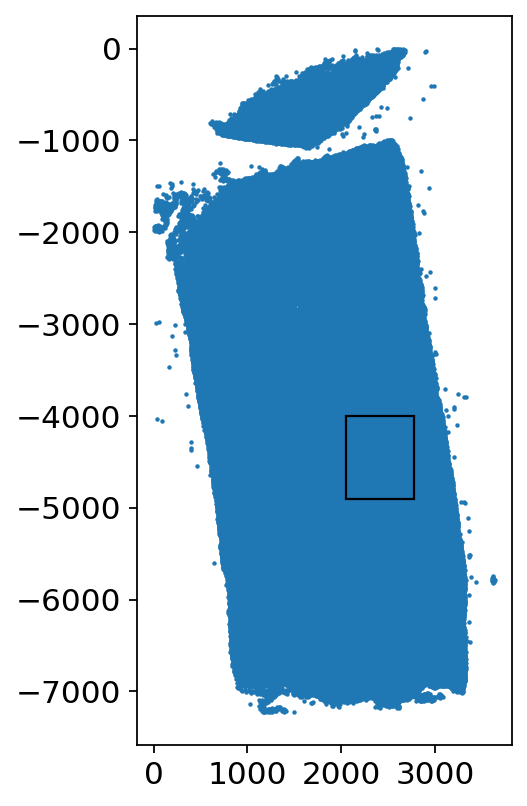

In [44]:
zoom_x = 2050
zoom_y = -4900

plt.figure(figsize=(3,6))
plt.scatter(*adata.obsm['spatial'].T, s=1)
rect = mpl.patches.Rectangle((zoom_x, zoom_y), zoom_width, zoom_height, edgecolor='k')
plt.gca().add_patch(rect)
plt.grid(None)
plt.show()

In [45]:
zdata = adata[adata.obsm['spatial'][:,0]>zoom_x]
zdata = zdata[zdata.obsm['spatial'][:,0]<zoom_x+zoom_width]
zdata = zdata[zdata.obsm['spatial'][:,1]>zoom_y]
zdata = zdata[zdata.obsm['spatial'][:,1]<zoom_y+zoom_height]

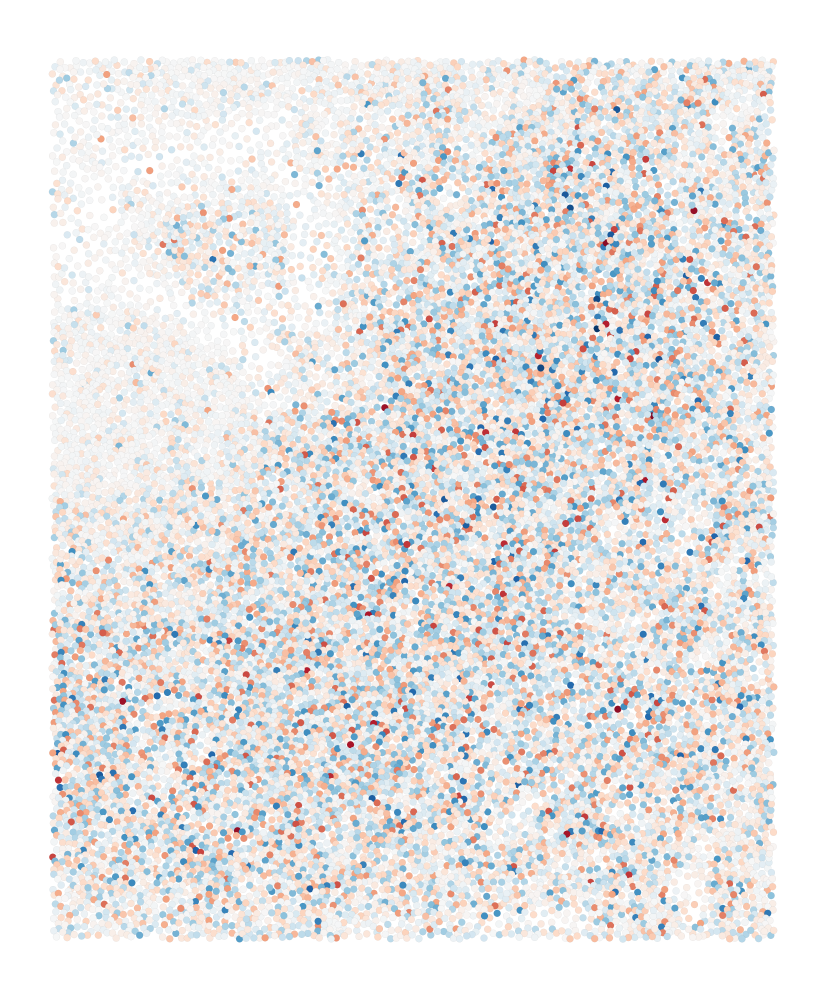

In [46]:
points = zdata.obsm['spatial']
plt.figure(figsize=(height*fignorm*(zoom_width/zoom_height), height*fignorm))
plt.scatter(
    points[:,0],
    points[:,1],
    edgecolor='k',
    linewidth=0.01,
    s=10,
    c=zdata.obsm['X_pca_highpass'][:,pc],
    cmap='RdBu_r',
    norm=norm,
)
plt.axis('off')
filename = os.path.join(figpath, f'ixn_tzone_zoom_pc{pc+1}.png')
plt.savefig(filename, dpi=300)
plt.show()

In [47]:
n_markers = 5
for i in range(n_comps):
    marker_idxs = np.argsort(adata.varm[f'X_pca_{filter_key}'][:,i])
    pos_marker_genes = adata.var_names[marker_idxs[::-1]][:n_markers]
    neg_marker_genes = adata.var_names[marker_idxs][:n_markers]

    print(f'========== PC{i+1} ==========')
    print('Positive markers: ', list(pos_marker_genes))
    print('Negative markers: ', list(neg_marker_genes))

========== PC1 ==========
Positive markers:  ['LAMP3', 'CSF2RA', 'CCR7', 'CCL19', 'CD1E']
Negative markers:  ['AQP3', 'CD247', 'CD3D', 'HLA-DQB2', 'CD28']
========== PC2 ==========
Positive markers:  ['CD8A', 'CD2', 'CTLA4', 'CD28', 'CCL19']
Negative markers:  ['CD3D', 'CD247', 'LAMP3', 'SST', 'TSPAN19']
========== PC3 ==========
Positive markers:  ['CD28', 'CD247', 'CCL19', 'DES', 'CD4']
Negative markers:  ['CD8A', 'CD3D', 'CD3E', 'FOXP3', 'IL7R']


#### PC3

In [49]:
# Set figure size
width = adata.obsm['spatial'][:,0].ptp()
height = adata.obsm['spatial'][:,1].ptp()
set_width = 4
fignorm = set_width / width
sc.set_figure_params(figsize=(set_width, height*fignorm))

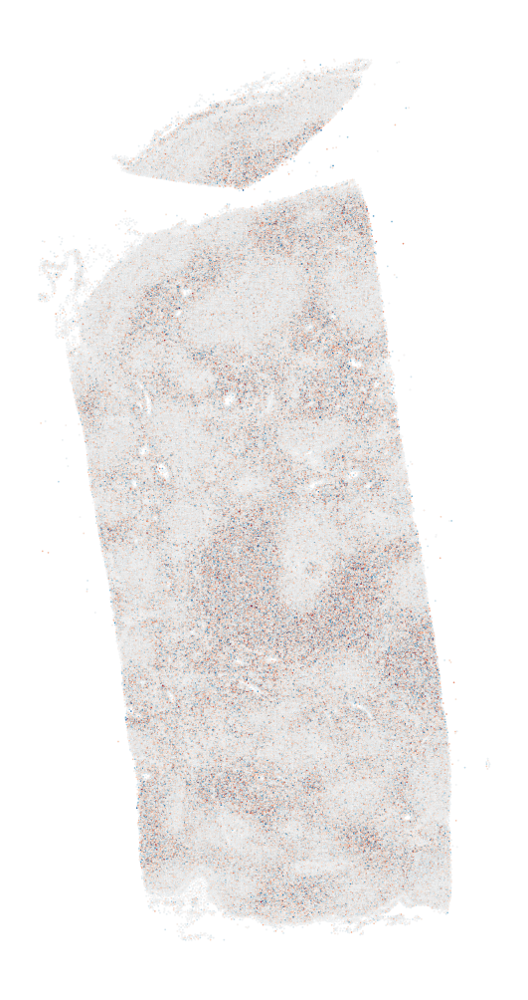

In [50]:
pc = 2
# adata.obs[f'PC{pc+1}'] = adata.obsm[f'X_pca_highpass'][:,pc]
c = adata.obsm['X_pca_highpass'][:,pc]
# norm = Normalize(vmin=-np.abs(c).max(), vmax=np.abs(c).max())
norm = TwoSlopeNorm(vcenter=0, vmin=c.min(), vmax=c.max())

points = adata.obsm['spatial']
plt.figure(figsize=(4,8))
plt.scatter(
    points[:,0],
    points[:,1],
    edgecolor='k',
    linewidth=0.005,
    s=0.5,
    c=c,
    cmap='RdBu_r',
    norm=norm,
)
plt.axis('off')
filename = os.path.join(figpath, f'ixn_paracortex_pc{pc+1}.png')
plt.savefig(filename, dpi=300)
plt.show()

In [51]:
# Set zoom dims
width = adata.obsm['spatial'][:,0].ptp()
height = adata.obsm['spatial'][:,1].ptp()
zoom_width = height/10
zoom_height = height/8

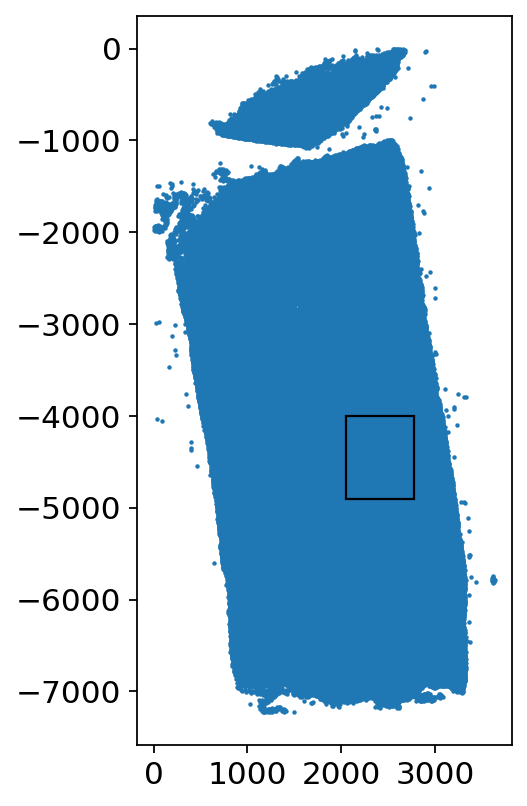

In [52]:
zoom_x = 2050
zoom_y = -4900

plt.figure(figsize=(3,6))
plt.scatter(*adata.obsm['spatial'].T, s=1)
rect = mpl.patches.Rectangle((zoom_x, zoom_y), zoom_width, zoom_height, edgecolor='k')
plt.gca().add_patch(rect)
plt.grid(None)
plt.show()

In [53]:
zdata = adata[adata.obsm['spatial'][:,0]>zoom_x]
zdata = zdata[zdata.obsm['spatial'][:,0]<zoom_x+zoom_width]
zdata = zdata[zdata.obsm['spatial'][:,1]>zoom_y]
zdata = zdata[zdata.obsm['spatial'][:,1]<zoom_y+zoom_height]

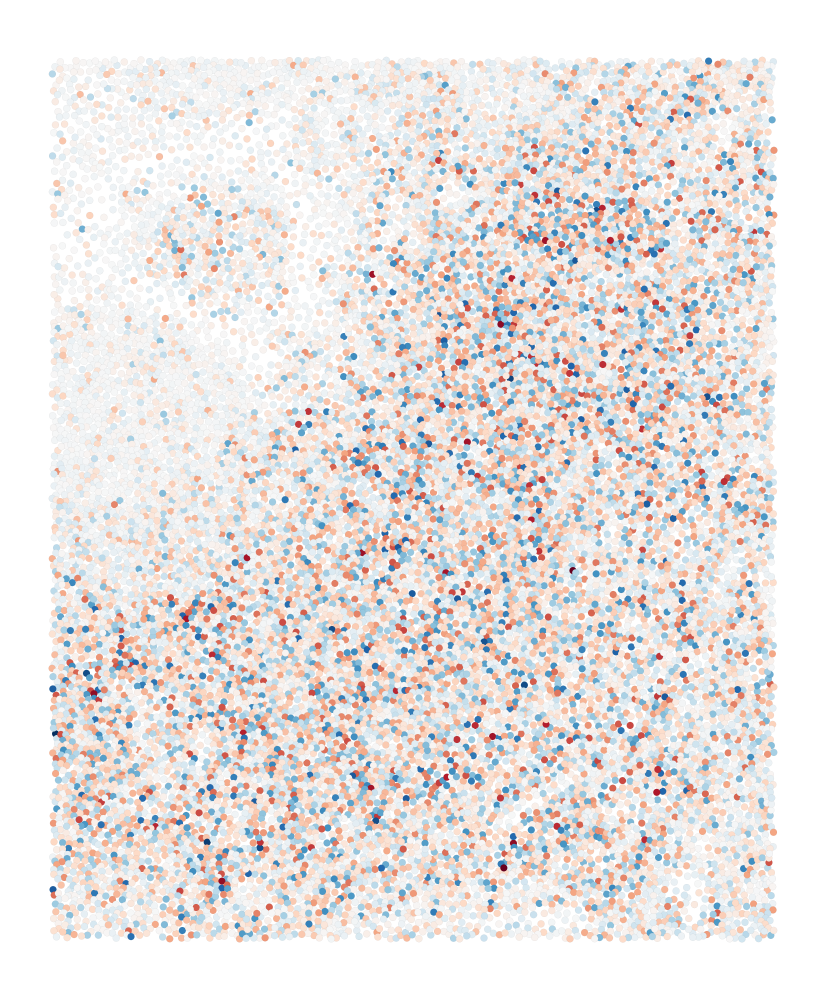

In [54]:
points = zdata.obsm['spatial']
plt.figure(figsize=(height*fignorm*(zoom_width/zoom_height), height*fignorm))
plt.scatter(
    points[:,0],
    points[:,1],
    edgecolor='k',
    linewidth=0.01,
    s=10,
    c=zdata.obsm['X_pca_highpass'][:,pc],
    cmap='RdBu_r',
    norm=norm,
)
plt.axis('off')
filename = os.path.join(figpath, f'ixn_tzone_zoom_pc{pc+1}.png')
plt.savefig(filename, dpi=300)
plt.show()

In [55]:
n_markers = 5
for i in range(n_comps):
    marker_idxs = np.argsort(adata.varm[f'X_pca_{filter_key}'][:,i])
    pos_marker_genes = adata.var_names[marker_idxs[::-1]][:n_markers]
    neg_marker_genes = adata.var_names[marker_idxs][:n_markers]

    print(f'========== PC{i+1} ==========')
    print('Positive markers: ', list(pos_marker_genes))
    print('Negative markers: ', list(neg_marker_genes))

========== PC1 ==========
Positive markers:  ['LAMP3', 'CSF2RA', 'CCR7', 'CCL19', 'CD1E']
Negative markers:  ['AQP3', 'CD247', 'CD3D', 'HLA-DQB2', 'CD28']
========== PC2 ==========
Positive markers:  ['CD8A', 'CD2', 'CTLA4', 'CD28', 'CCL19']
Negative markers:  ['CD3D', 'CD247', 'LAMP3', 'SST', 'TSPAN19']
========== PC3 ==========
Positive markers:  ['CD28', 'CD247', 'CCL19', 'DES', 'CD4']
Negative markers:  ['CD8A', 'CD3D', 'CD3E', 'FOXP3', 'IL7R']


#### GO terms

==================== PC1 ====================


,Term,Adjusted P-value,Genes
0,Negative Regulation Of Dendritic Cell Apoptoti...,0.000536,CCR7;CCL19
1,Regulation Of Dendritic Cell Apoptotic Process...,0.000536,CCR7;CCL19
2,Response To Prostaglandin E (GO:0034695),0.000536,CCR7;CCL19
3,Negative Regulation Of Leukocyte Apoptotic Pro...,0.000536,CCR7;CCL19
4,Response To Nitric Oxide (GO:0071731),0.000536,CCR7;CCL19
5,Positive Regulation Of T Cell Activation (GO:0...,0.000542,CD274;CCR7;CCL19
6,Positive Regulation Of Glycoprotein Biosynthet...,0.000542,CCR7;CCL19
7,Response To Cytokine (GO:0034097),0.000744,CD274;LAMP3;CCR7
8,Positive Regulation Of Neutrophil Chemotaxis (...,0.000744,CCR7;CCL19
9,Dendritic Cell Migration (GO:0036336),0.000744,CCR7;CCL19


/stanley/WangLab/kamal/envs/xax/lib/python3.9/site-packages/gseapy/plot.py:671: FutureWarning: The 'method' keyword in Series.replace is deprecated and will be removed in a future version.
  df[self.colname].replace(
/stanley/WangLab/kamal/envs/xax/lib/python3.9/site-packages/gseapy/plot.py:671: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[self.colname].replace(


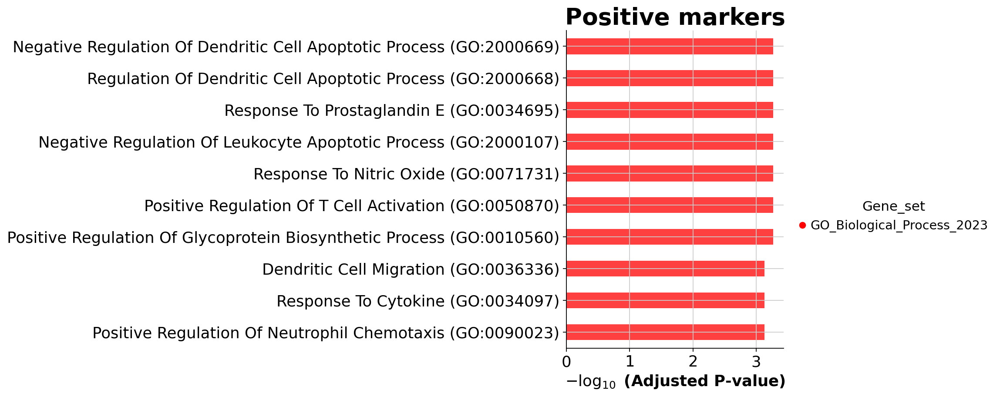

,Term,Adjusted P-value,Genes
0,Alpha-Beta T Cell Activation (GO:0046631),0.000004,CD247;CD3E;CD3D
1,T Cell Receptor Signaling Pathway (GO:0050852),0.000005,CD28;CD247;CD3E;CD3D
2,T Cell Activation (GO:0042110),0.000006,CD28;CD247;CD3E;CD3D
3,Antigen Receptor-Mediated Signaling Pathway (G...,0.000010,CD28;CD247;CD3E;CD3D
4,Positive Regulation Of T Cell Activation (GO:0...,0.000362,CD28;CD3E;HLA-DQB2
5,Positive Regulation Of T Cell Proliferation (G...,0.007977,CD28;CD3E
6,Positive Regulation Of Lymphocyte Proliferatio...,0.008389,CD28;CD3E
7,Regulation Of T Cell Proliferation (GO:0042129),0.008389,CD28;CD3E
8,Protein-Containing Complex Organization (GO:00...,0.019809,CD247;CD3E
9,Positive Regulation Of Cell-Cell Adhesion Medi...,0.025953,CD3E


/stanley/WangLab/kamal/envs/xax/lib/python3.9/site-packages/gseapy/plot.py:671: FutureWarning: The 'method' keyword in Series.replace is deprecated and will be removed in a future version.
  df[self.colname].replace(
/stanley/WangLab/kamal/envs/xax/lib/python3.9/site-packages/gseapy/plot.py:671: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[self.colname].replace(


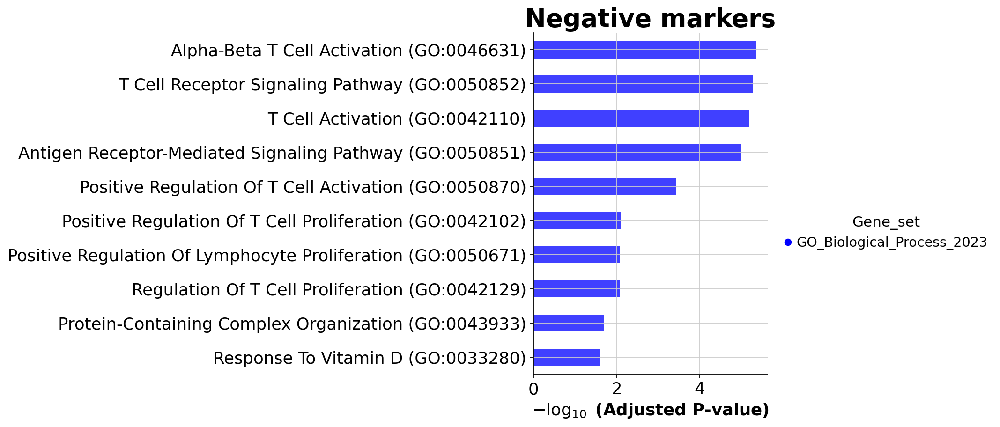

==================== PC2 ====================


,Term,Adjusted P-value,Genes
0,T Cell Activation (GO:0042110),2.595142e-07,CD2;CD8A;CD28;CCL19;FOXP3
1,T Cell Differentiation (GO:0030217),1.479278e-04,CD8A;CD28;FOXP3
2,Regulation Of T Cell Proliferation (GO:0042129),4.713783e-04,CD28;CCL19;FOXP3
3,T Cell Receptor Signaling Pathway (GO:0050852),6.658038e-04,CD8A;CD28;CTLA4
4,Negative Regulation Of T Cell Mediated Immunit...,8.415632e-04,KLRD1;FOXP3
5,Lymphocyte Mediated Immunity (GO:0002449),8.415632e-04,CD8A;KLRD1
6,Regulation Of Natural Killer Cell Activation (...,8.415632e-04,KLRD1;PRDM1
7,Antigen Receptor-Mediated Signaling Pathway (G...,9.319897e-04,CD8A;CD28;CTLA4
8,Regulation Of Lymphocyte Differentiation (GO:0...,9.319897e-04,CD2;PRDM1
9,Regulation Of Regulatory T Cell Differentiatio...,1.029273e-03,CTLA4;FOXP3


/stanley/WangLab/kamal/envs/xax/lib/python3.9/site-packages/gseapy/plot.py:671: FutureWarning: The 'method' keyword in Series.replace is deprecated and will be removed in a future version.
  df[self.colname].replace(
/stanley/WangLab/kamal/envs/xax/lib/python3.9/site-packages/gseapy/plot.py:671: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[self.colname].replace(


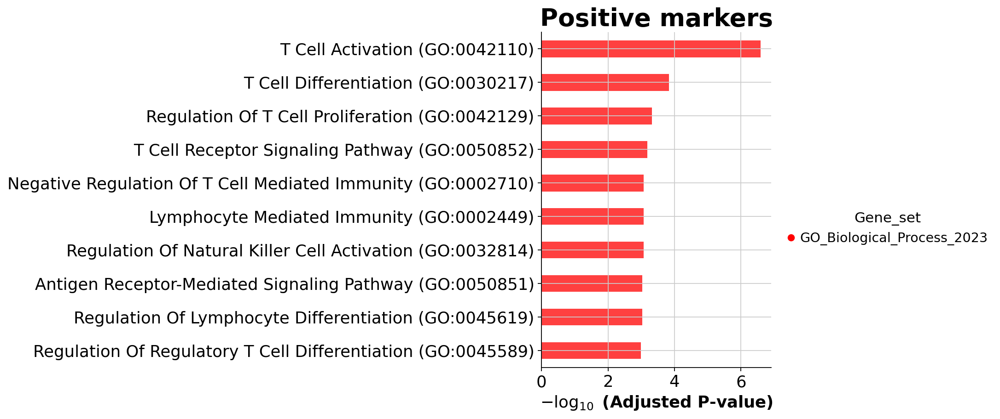

,Term,Adjusted P-value,Genes
0,Alpha-Beta T Cell Activation (GO:0046631),0.002048,CD247;CD3D
1,T Cell Receptor Signaling Pathway (GO:0050852),0.028967,CD247;CD3D
2,T Cell Activation (GO:0042110),0.028967,CD247;CD3D
3,Antigen Receptor-Mediated Signaling Pathway (G...,0.028967,CD247;CD3D
4,Autocrine Signaling (GO:0035425),0.028967,SERPINB3
5,Regulation Of Relaxation Of Cardiac Muscle (GO...,0.028967,CHGA
6,Positive Regulation Of Striated Muscle Contrac...,0.028967,CHGA
7,Negative Regulation Of Catecholamine Secretion...,0.028967,CHGA
8,Negative Regulation Of Hematopoietic Progenito...,0.028967,TCF15
9,Relaxation Of Cardiac Muscle (GO:0055119),0.040054,CHGA


/stanley/WangLab/kamal/envs/xax/lib/python3.9/site-packages/gseapy/plot.py:671: FutureWarning: The 'method' keyword in Series.replace is deprecated and will be removed in a future version.
  df[self.colname].replace(
/stanley/WangLab/kamal/envs/xax/lib/python3.9/site-packages/gseapy/plot.py:671: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[self.colname].replace(


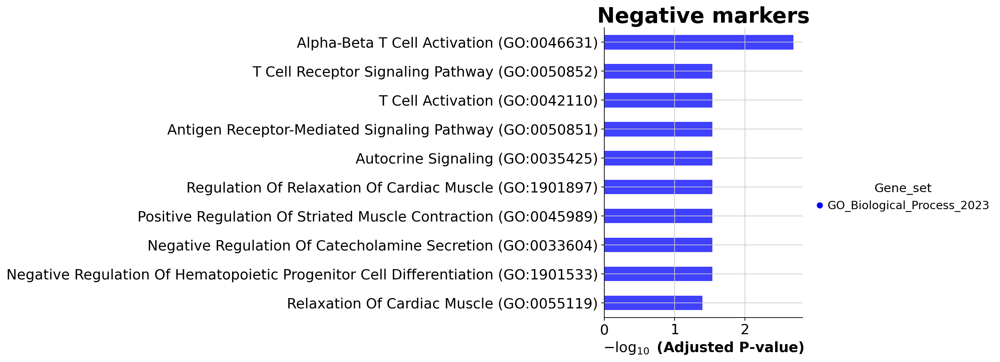

==================== PC3 ====================


,Term,Adjusted P-value,Genes
0,T Cell Activation (GO:0042110),3.472039e-07,CD4;CD28;CCR7;CD247;CCL19
1,Dendritic Cell Migration (GO:0036336),1.071689e-05,CCL5;CCR7;CCL19
2,Positive Regulation Of T Cell Activation (GO:0...,1.549104e-05,CCL5;CD28;CCR7;CCL19
3,Positive Regulation Of Protein Kinase Activity...,3.941076e-05,CD4;CCL5;CCR7;CCL19
4,Positive Regulation Of ERK1 And ERK2 Cascade (...,7.320673e-05,CD4;CCL5;CCR7;CCL19
5,Negative Regulation Of Dendritic Cell Apoptoti...,1.569226e-04,CCR7;CCL19
6,Positive Regulation Of T Cell Proliferation (G...,1.569226e-04,CCL5;CD28;CCL19
7,Regulation Of ERK1 And ERK2 Cascade (GO:0070372),1.569226e-04,CD4;CCL5;CCR7;CCL19
8,Myeloid Leukocyte Differentiation (GO:0002573),1.645113e-04,CD4;CCR7;CCL19
9,Positive Regulation Of Lymphocyte Proliferatio...,1.677946e-04,CCL5;CD28;CCL19


/stanley/WangLab/kamal/envs/xax/lib/python3.9/site-packages/gseapy/plot.py:671: FutureWarning: The 'method' keyword in Series.replace is deprecated and will be removed in a future version.
  df[self.colname].replace(
/stanley/WangLab/kamal/envs/xax/lib/python3.9/site-packages/gseapy/plot.py:671: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[self.colname].replace(


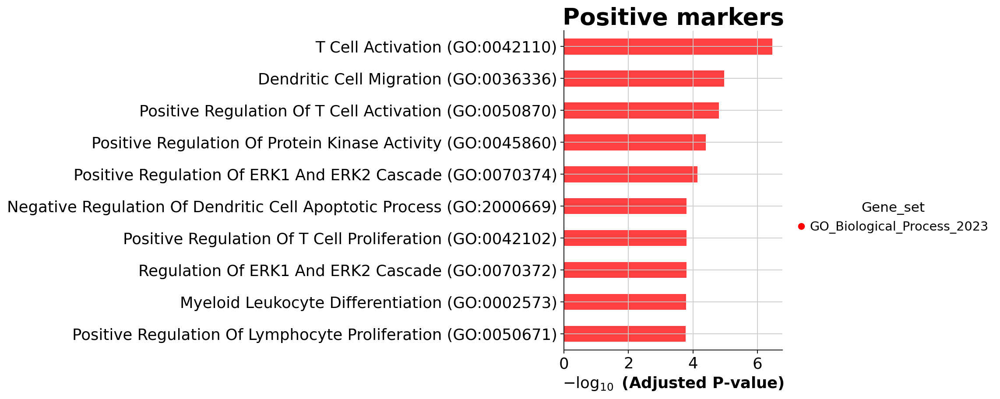

,Term,Adjusted P-value,Genes
0,T Cell Activation (GO:0042110),0.000024,CD8A;CD3E;CD3D;FOXP3
1,T Cell Receptor Signaling Pathway (GO:0050852),0.000771,CD8A;CD3E;CD3D
2,Negative Regulation Of T Cell Mediated Immunit...,0.000771,KLRC1;FOXP3
3,Alpha-Beta T Cell Activation (GO:0046631),0.000771,CD3E;CD3D
4,Antigen Receptor-Mediated Signaling Pathway (G...,0.000893,CD8A;CD3E;CD3D
5,T Cell Mediated Immunity (GO:0002456),0.000929,CD8A;PRF1
6,Regulation Of Natural Killer Cell Mediated Cyt...,0.002072,KLRB1;KLRC1
7,T Cell Differentiation (GO:0030217),0.003769,CD8A;FOXP3
8,Regulation Of T Cell Proliferation (GO:0042129),0.009393,CD3E;FOXP3
9,Enzyme-Linked Receptor Protein Signaling Pathw...,0.021758,CD8A;CD3E


/stanley/WangLab/kamal/envs/xax/lib/python3.9/site-packages/gseapy/plot.py:671: FutureWarning: The 'method' keyword in Series.replace is deprecated and will be removed in a future version.
  df[self.colname].replace(
/stanley/WangLab/kamal/envs/xax/lib/python3.9/site-packages/gseapy/plot.py:671: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df[self.colname].replace(


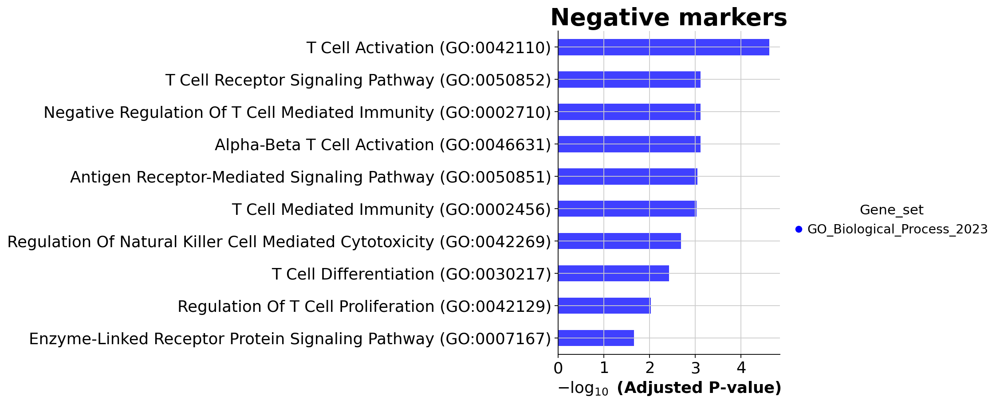

In [56]:
# n_markers = int(adata.shape[1] * 0.01) # top 1% of genes
n_markers = 10
gene_sets = [
    'GO_Biological_Process_2023',
    # 'GO_Molecular_Function_2023',
    # 'WikiPathways_2019_Mouse',
    # 'Elsevier_Pathway_Collection',
    # 'PFOCR_Pathways',
]
cutoff = 0.05

for i in range(n_comps):

    print('='*20, f'PC{i+1}', '='*20)
    
    marker_idxs = np.argsort(adata.varm[f'X_pca_{filter_key}'][:,i])
    pos_marker_genes = adata.var_names[marker_idxs[::-1]][:n_markers]
    neg_marker_genes = adata.var_names[marker_idxs][:n_markers]

    enrichment = gp.enrichr(
        gene_list=list(pos_marker_genes),
        organism='Mouse',
        gene_sets=gene_sets,
    )
    try:
        df = enrichment.results
        display(df[['Term', 'Adjusted P-value', 'Genes']][df['Adjusted P-value'] < cutoff][:20])
        fig = gp.barplot(df, title='Positive markers', group='Gene_set', color=['r'], cutoff=cutoff)
        plt.show()
    except:
        print('No significant terms')

    enrichment = gp.enrichr(
        gene_list=list(neg_marker_genes),
        organism='Mouse',
        gene_sets=gene_sets,
    )
    try:
        df = enrichment.results
        display(df[['Term', 'Adjusted P-value', 'Genes']][df['Adjusted P-value'] < cutoff][:20])
        fig = gp.barplot(df, title='Negative markers', group='Gene_set', color=['b'], cutoff=cutoff)
        plt.show()
    except:
        print('No significant terms')